<a href="https://colab.research.google.com/github/zelal-Eizaldeen/ML_project1_CS598_PSL/blob/main/EDA_timeSeries.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Handle Time series

In [1]:
import pandas as pd
import numpy as np

#Vis
import matplotlib.pyplot as plt
import seaborn as sns

#ML
#importing libraries
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn import metrics



In [2]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
DATA_DIR='/content/drive/MyDrive/MastersDegree/CS598 PSL/Assignments/Projects/Project2/MyCode/Proj2_Data'

In [4]:
def preprocess(data):

    data.isna().sum()[data.isna().sum() > 0].sort_values(ascending=False)
    data.fillna(0, inplace = True)


    data['Date'] = pd.to_datetime(data['Date'])



    data['Wk'] =   data['Date'].dt.isocalendar().week
    data['Yr'] =   data['Date'].dt.year
    # data['Month'] =   data['Date'].dt.month

    data['Wk'] = pd.Categorical(data['Wk'], categories=[i for i in range(1, 53)])  # 52 weeks
    data['IsHoliday'] = data['IsHoliday'].apply(int)

    return data

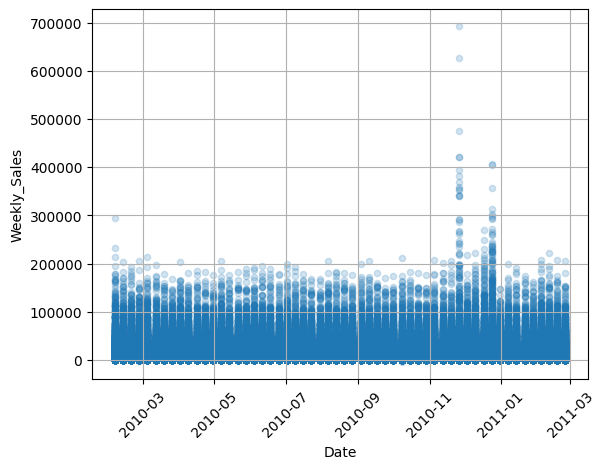

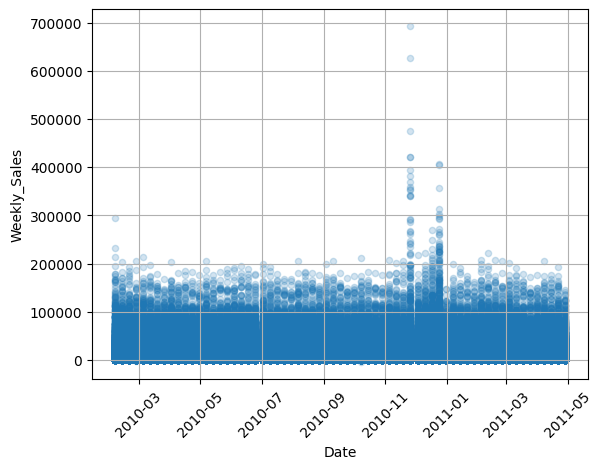

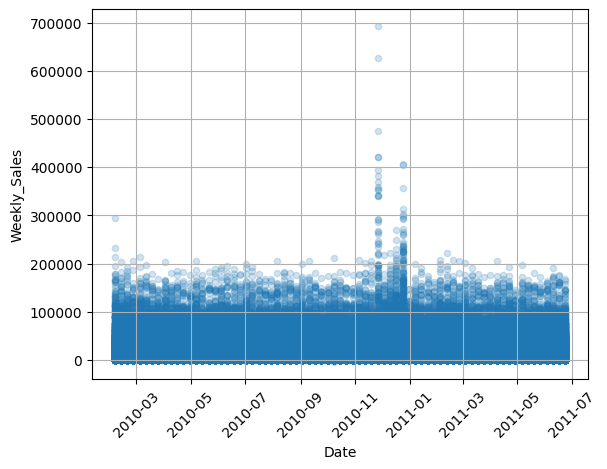

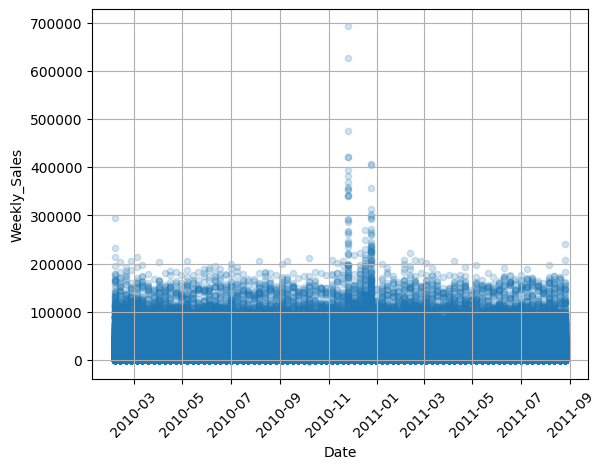

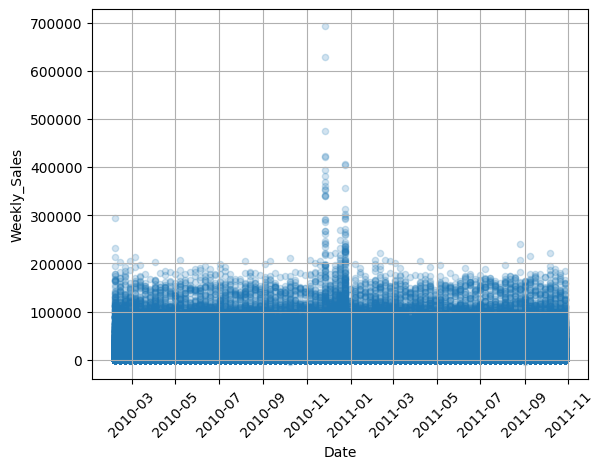

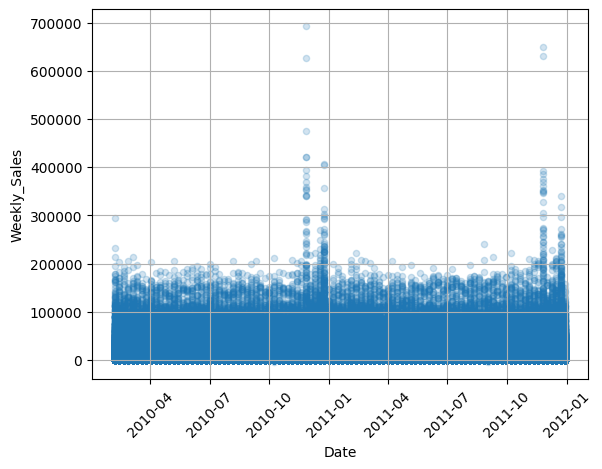

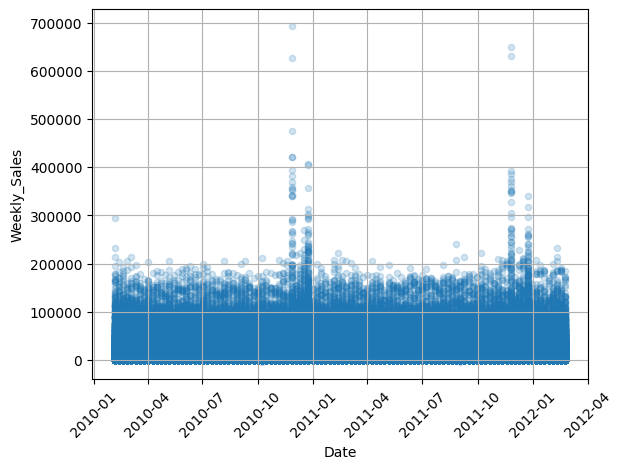

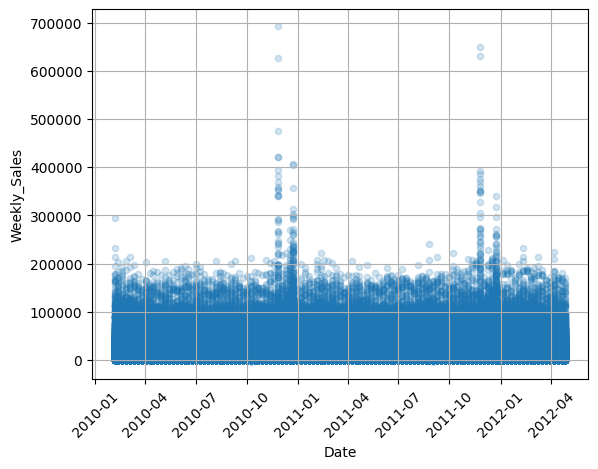

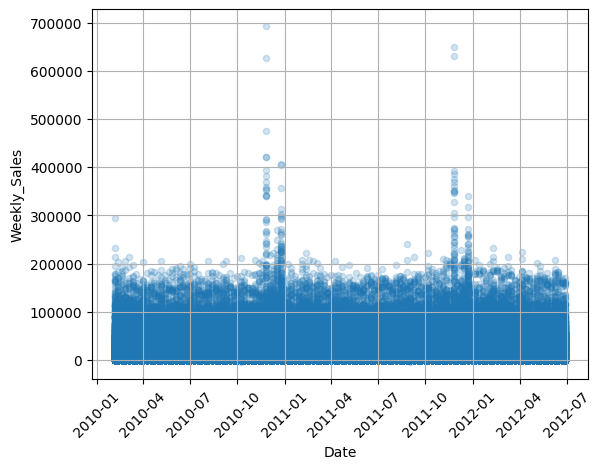

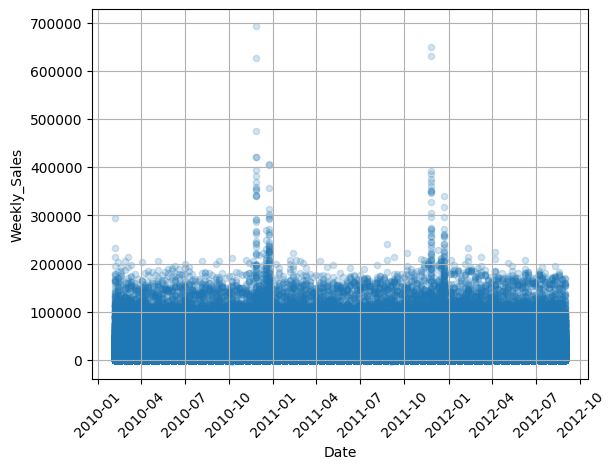

In [19]:
for i in range(10):

    # Read data for current fold
    train = pd.read_csv(f'{DATA_DIR}/fold_{i+1}/train.csv')
    test = pd.read_csv(f'{DATA_DIR}/fold_{i+1}/test.csv')

    train=preprocess(train)
    test=preprocess(test)


    test_with_label = pd.read_csv(f'{DATA_DIR}/test_with_label.csv')

    train.plot(kind="scatter", x="Date", y="Weekly_Sales", grid=True,alpha=0.2)
    plt.xticks(rotation=45)
    plt.show()





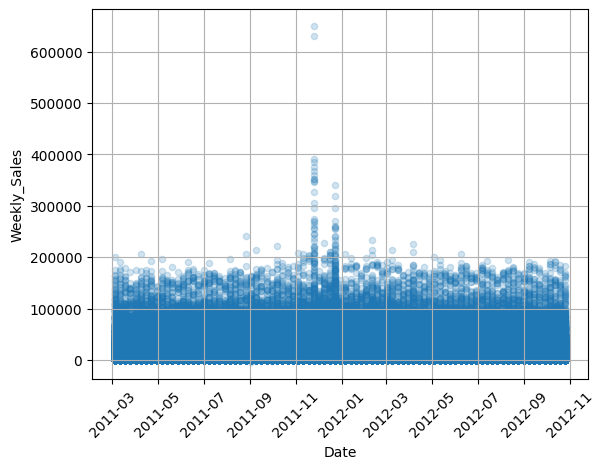

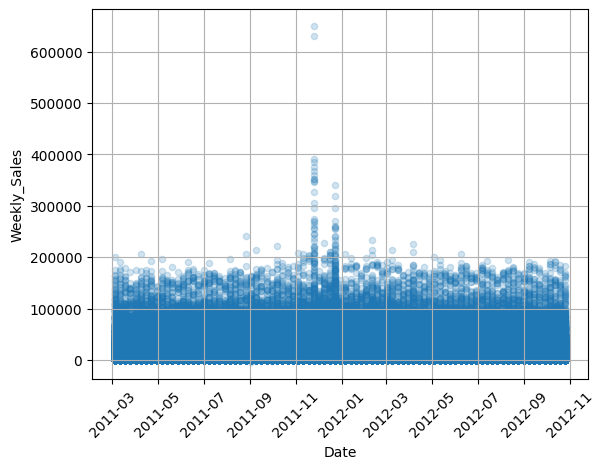

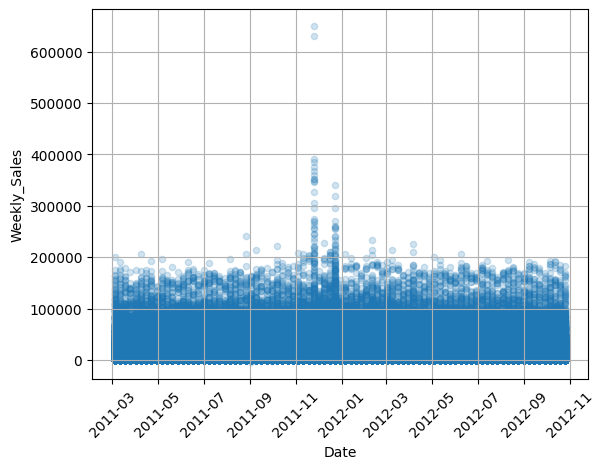

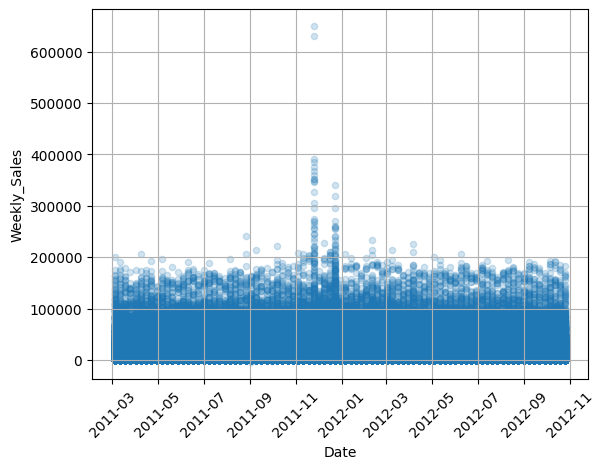

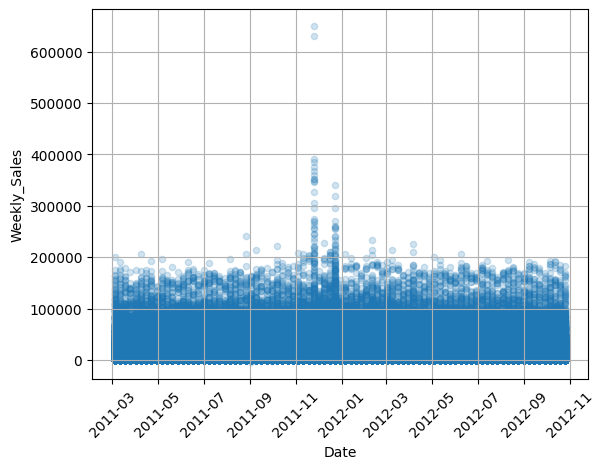

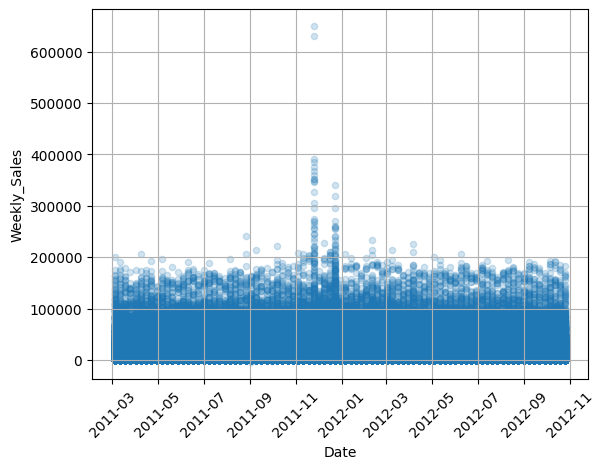

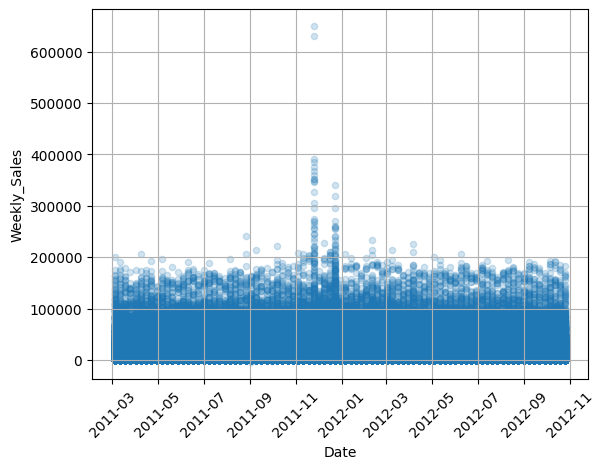

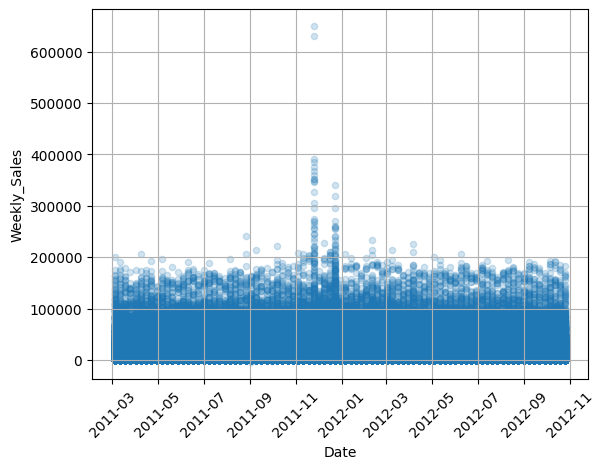

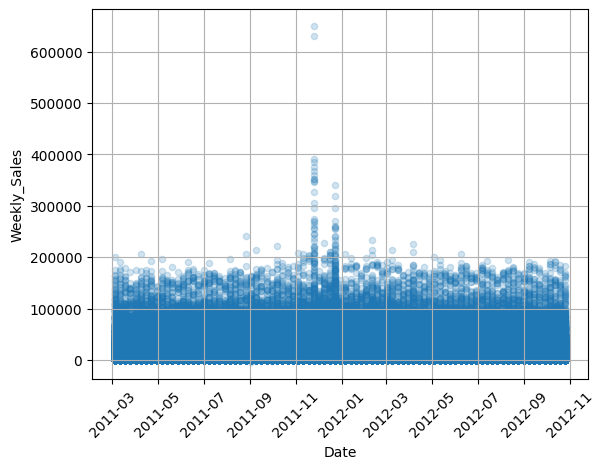

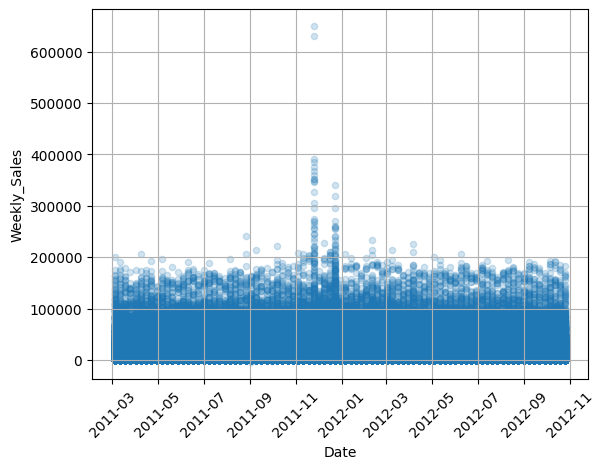

In [18]:
for i in range(10):

    # Read data for current fold



    test_with_label = pd.read_csv(f'{DATA_DIR}/test_with_label.csv')

    test_with_label=preprocess(test_with_label)

    test_with_label.plot(kind="scatter", x="Date", y="Weekly_Sales", grid=True,alpha=0.2)
    plt.xticks(rotation=45)
    plt.show()


In [ ]:
for i in range(10):

    # Read data for current fold
    pred = pd.read_csv(f'{DATA_DIR}/fold_{i+1}/mypred.csv')
    pred=preprocess(pred)

    pred.plot(kind="scatter", x="Date", y="Weekly_Pred", grid=True,alpha=0.2)
    plt.xticks(rotation=45)
    plt.show()


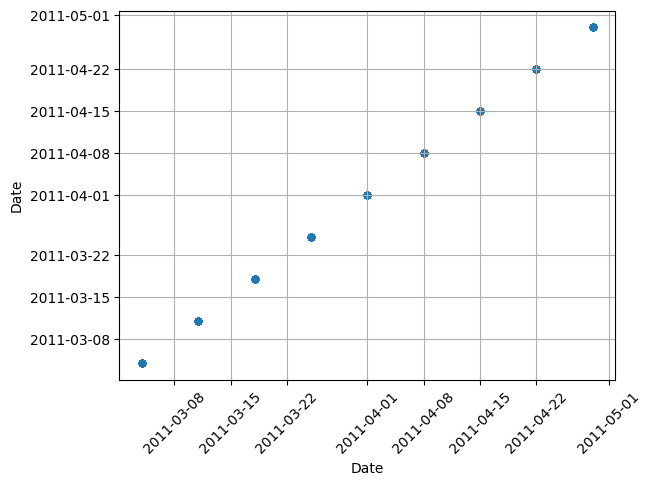

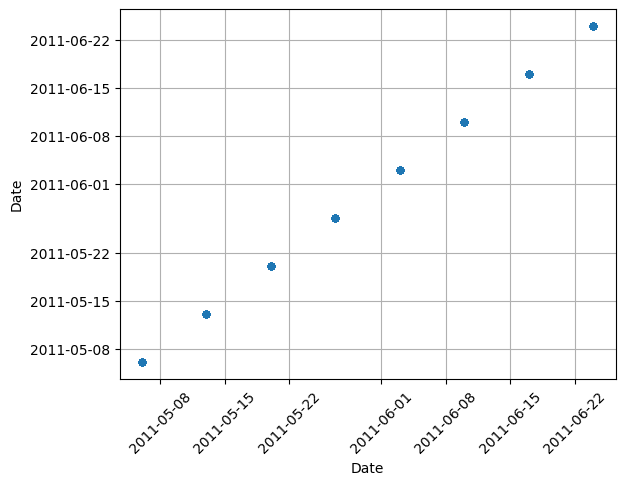

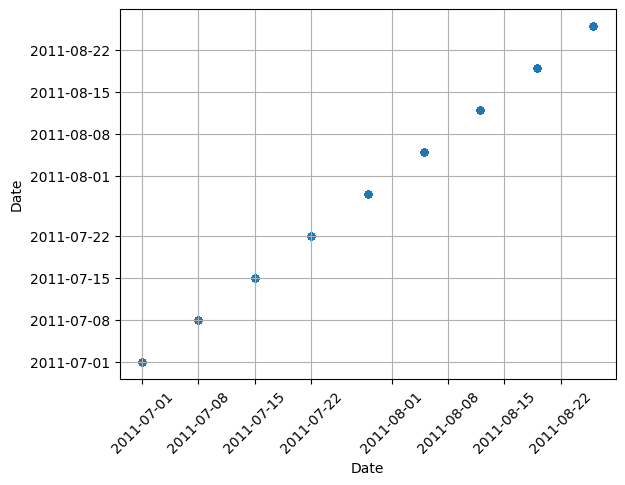

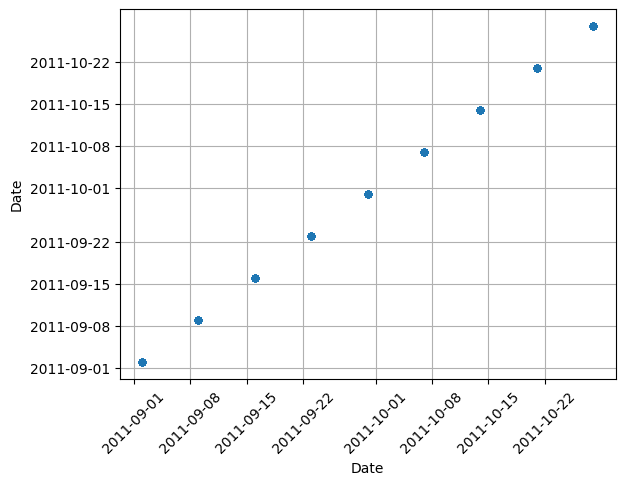

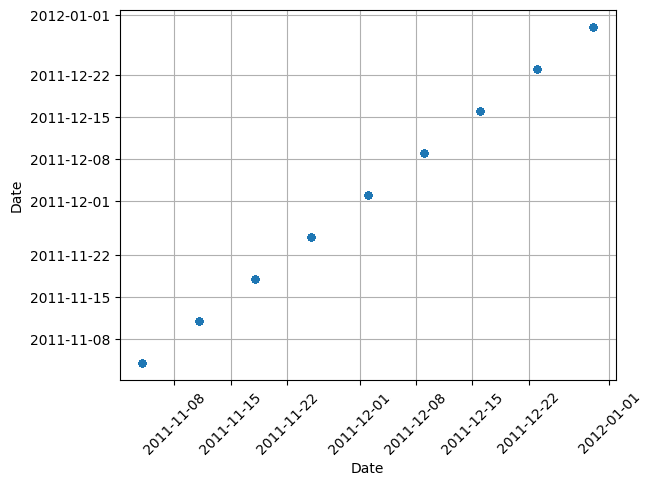

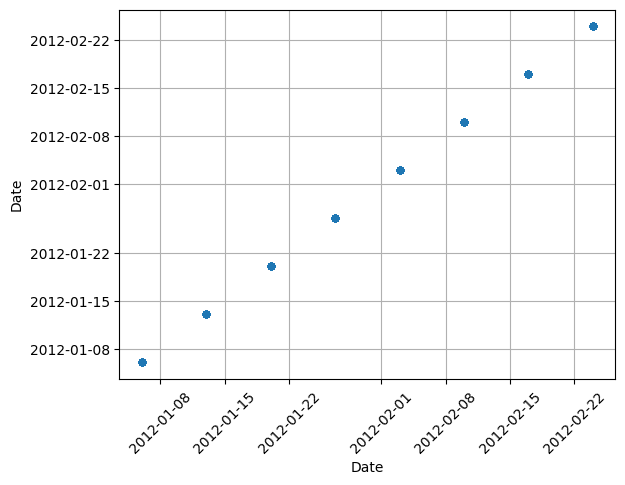

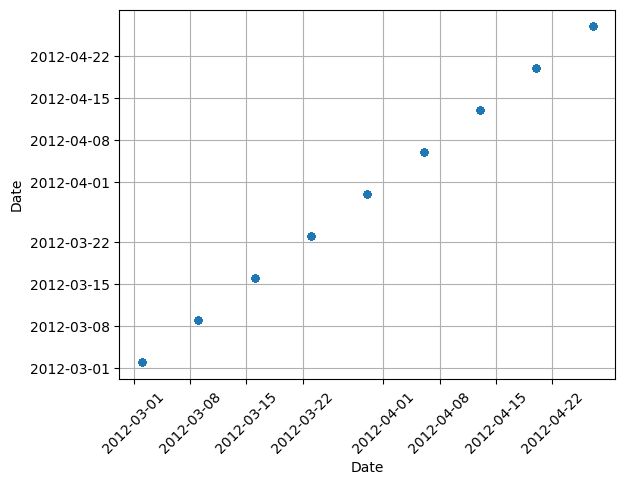

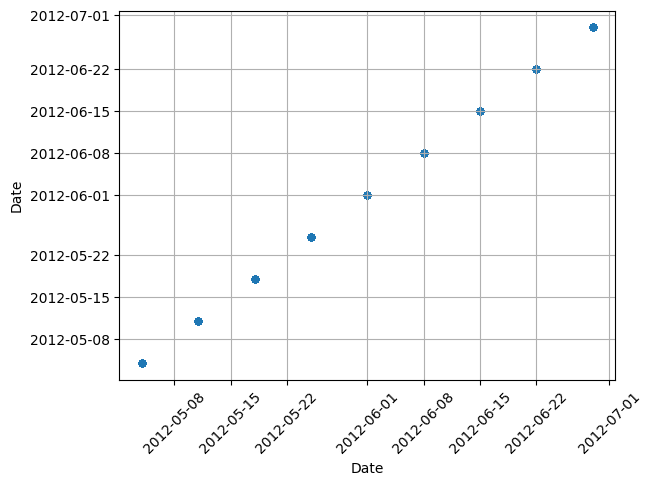

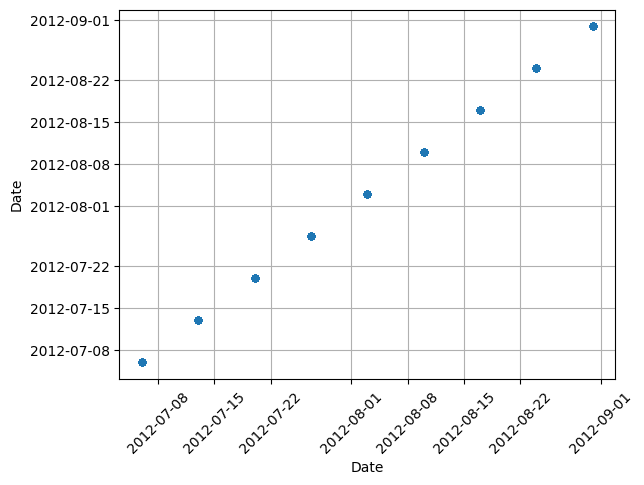

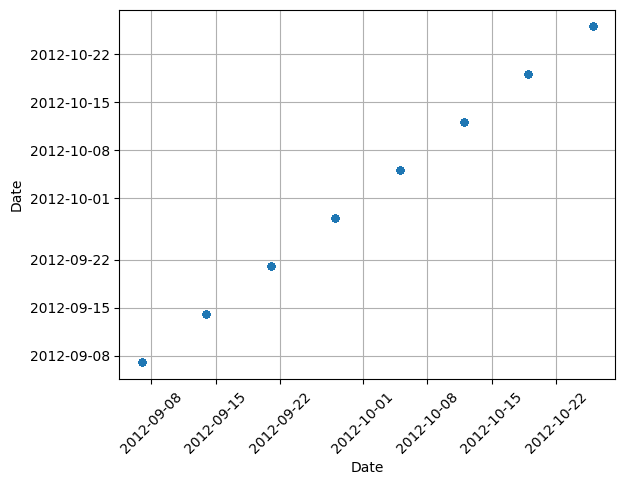

In [21]:
for i in range(10):

    # Read data for current fold
    test = pd.read_csv(f'{DATA_DIR}/fold_{i+1}/test.csv')
    test=preprocess(test)

    test.plot(kind="scatter", x="Date", y="Date", grid=True,alpha=0.2)
    plt.xticks(rotation=45)
    plt.show()

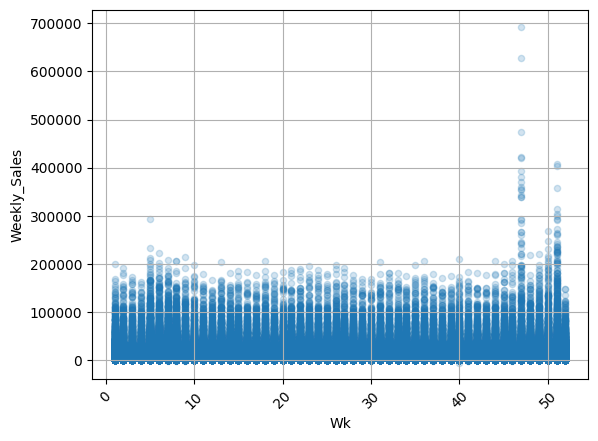

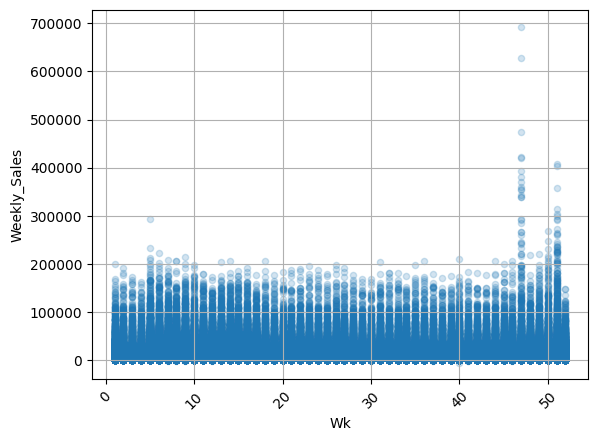

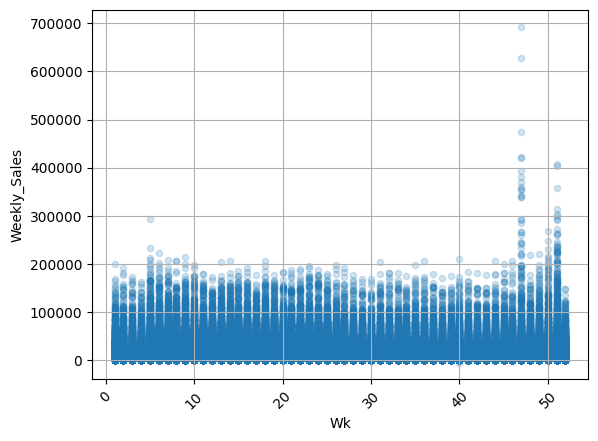

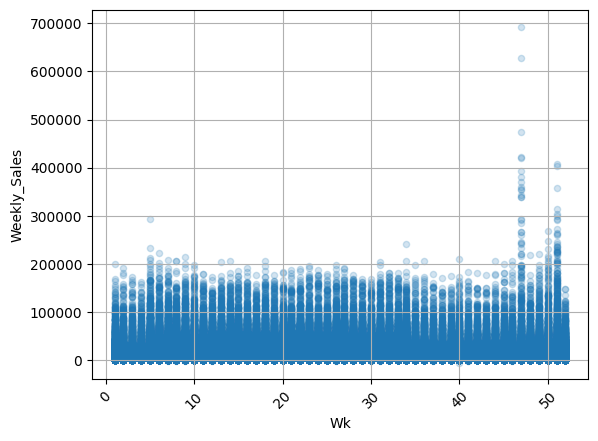

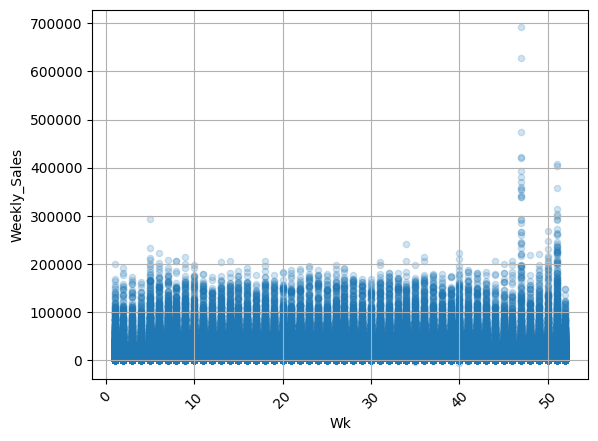

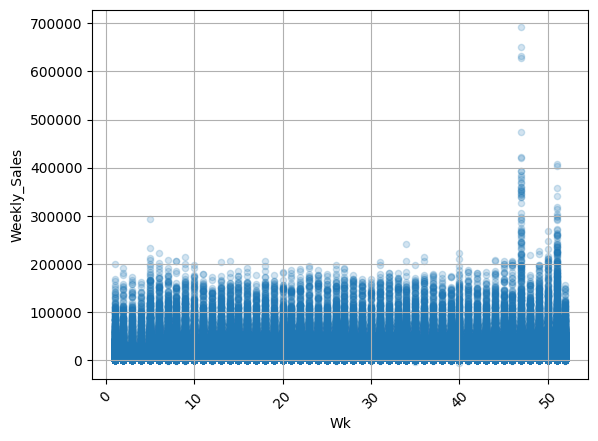

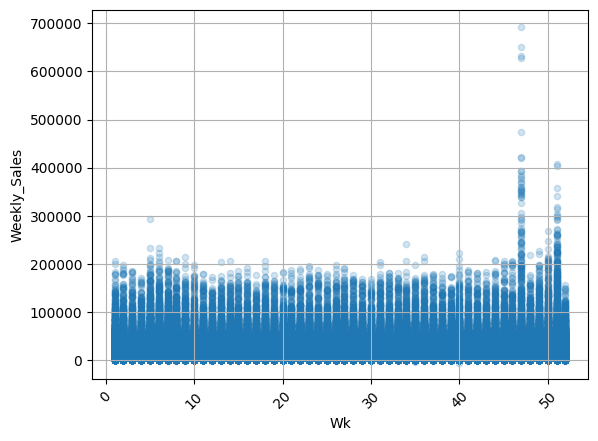

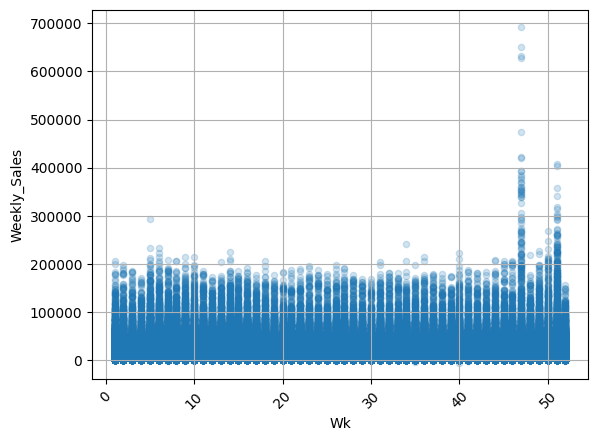

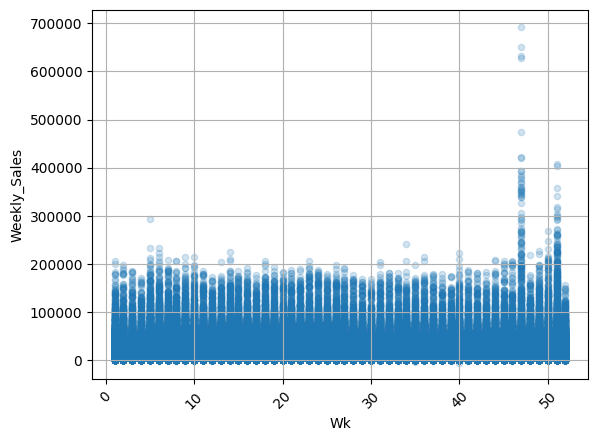

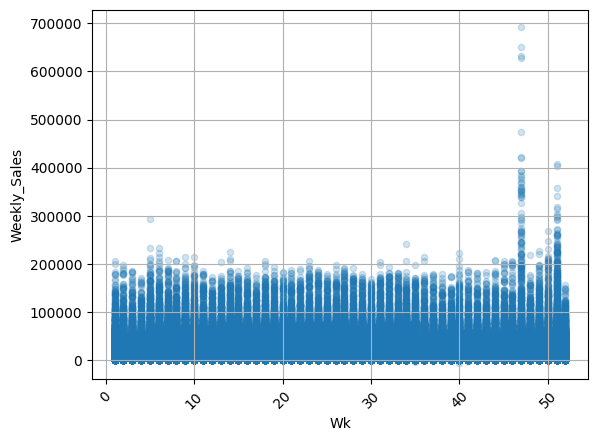

In [23]:
for i in range(10):

    # Read data for current fold



    train = pd.read_csv(f'{DATA_DIR}/fold_{i+1}/train.csv')

    train=preprocess(train)

    train.plot(kind="scatter", x="Wk", y="Weekly_Sales", grid=True,alpha=0.2)
    plt.xticks(rotation=45)
    plt.show()

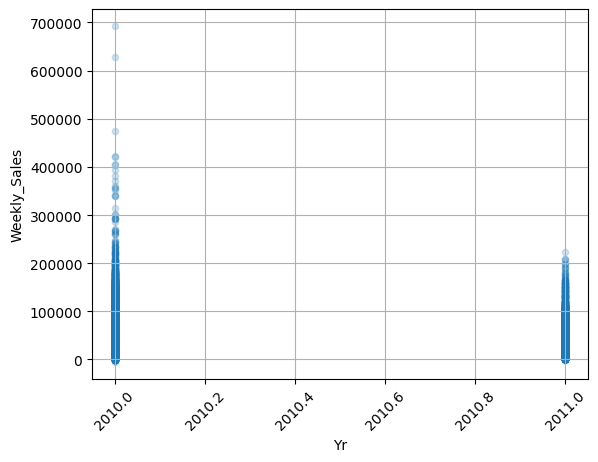

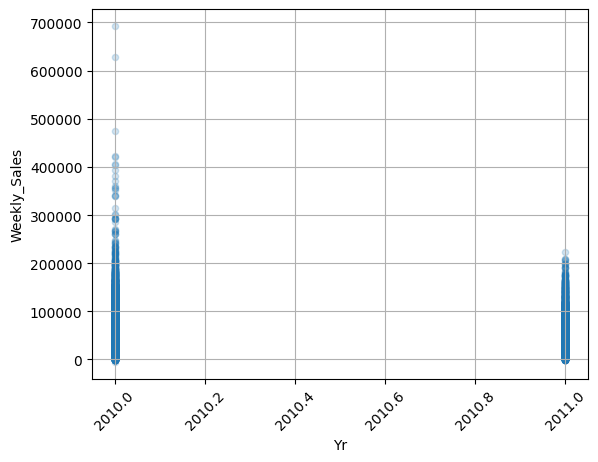

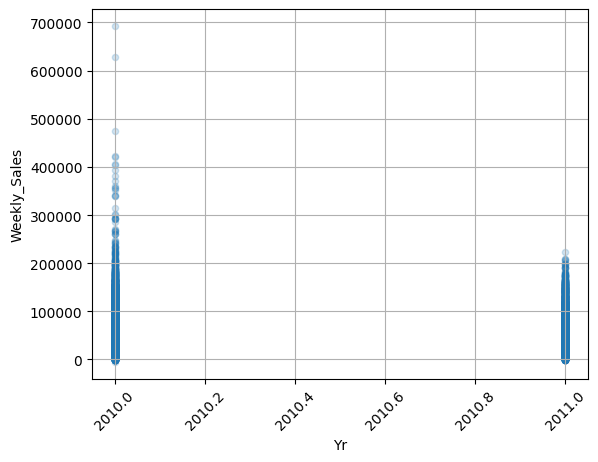

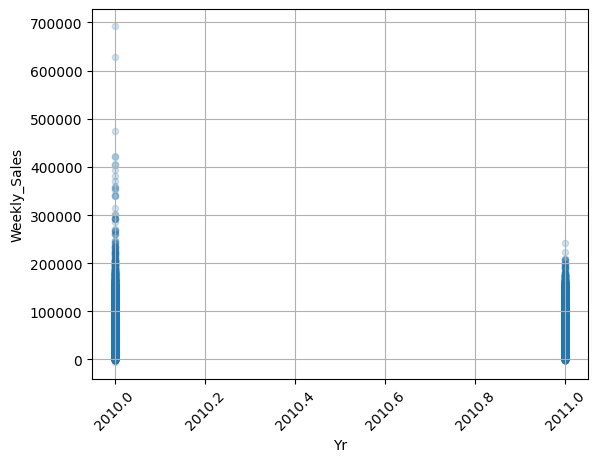

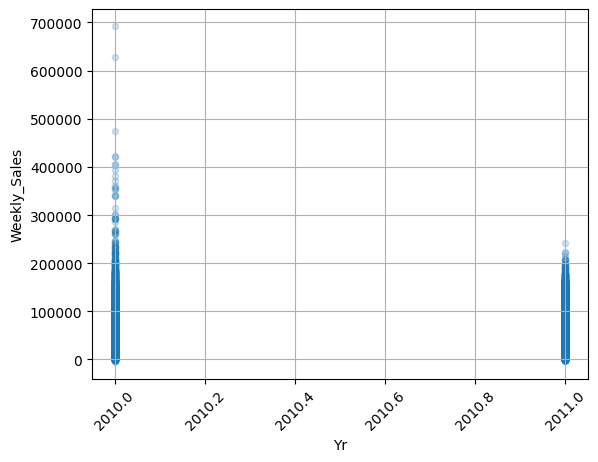

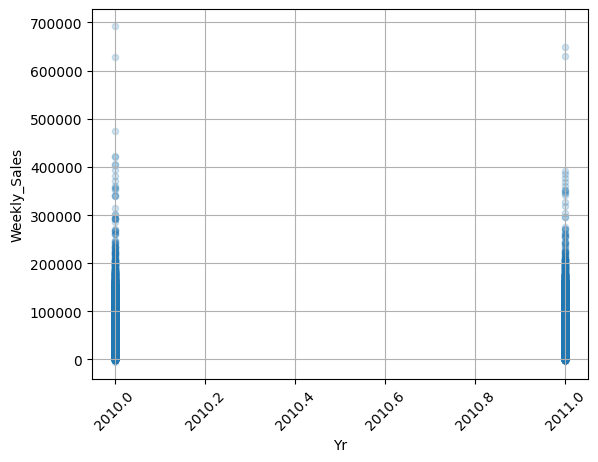

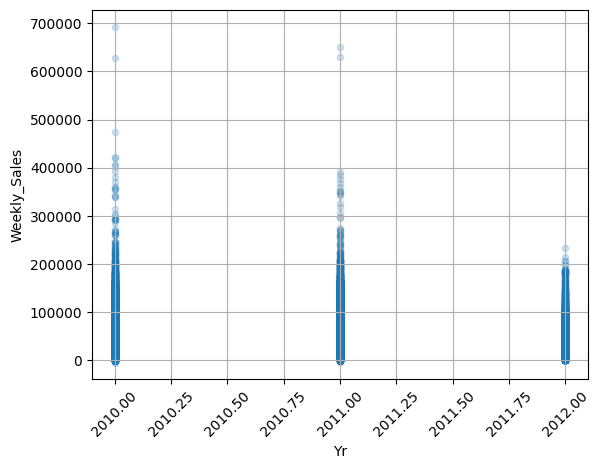

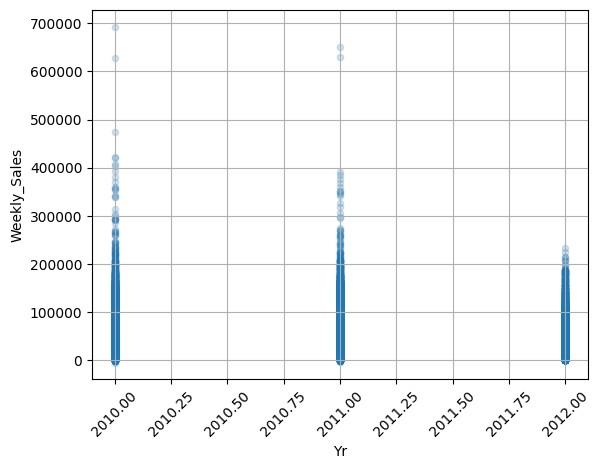

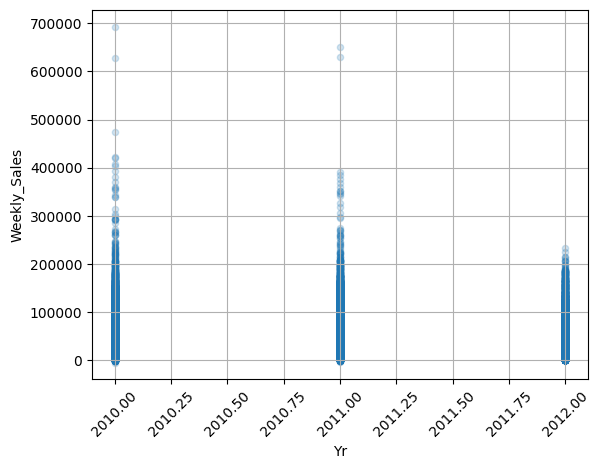

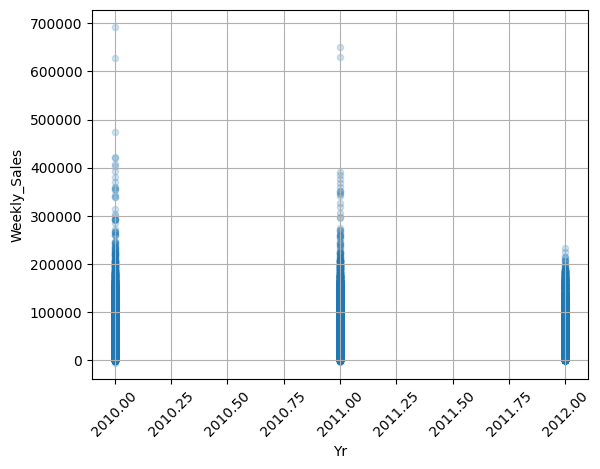

In [24]:
for i in range(10):

    # Read data for current fold



    train = pd.read_csv(f'{DATA_DIR}/fold_{i+1}/train.csv')

    train=preprocess(train)

    train.plot(kind="scatter", x="Yr", y="Weekly_Sales", grid=True,alpha=0.2)
    plt.xticks(rotation=45)
    plt.show()

In [115]:
train.dtypes


,0
Store,int64
Dept,int64
Date,datetime64[ns]
Weekly_Sales,float64
IsHoliday,int64
Wk,category
Yr,int32


In [ ]:
#Missing Values
housing.dropna(subset=["total_bedrooms"], inplace=True)  # option 1

housing.drop("total_bedrooms", axis=1)  # option 2

median = housing["total_bedrooms"].median()  # option 3
housing["total_bedrooms"].fillna(median, inplace=True)

In [ ]:
#Missing values
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy="median")
housing_num = housing.select_dtypes(include=[np.number])
imputer.fit(housing_num)
X = imputer.transform(housing_num)


In [120]:
#Categorical vars
from sklearn.preprocessing import OrdinalEncoder
train_cat = train[["Wk"]]

ordinal_encoder = OrdinalEncoder()
housing_cat_encoded = ordinal_encoder.fit_transform(train_cat)
housing_cat_encoded[:8].shape

###Better

from sklearn.preprocessing import OneHotEncoder

cat_encoder = OneHotEncoder()
housing_cat_1hot = cat_encoder.fit_transform(housing_cat)

(8, 7)

In [7]:
# Display a random sampling of 5 rows
train.sample(5, random_state=0)

,Store,Dept,Date,Weekly_Sales,IsHoliday
12026,2,19,2011-11-25,4002.66,True
180294,20,28,2011-01-14,687.12,False
101450,11,96,2011-01-28,19266.73,False
73429,8,92,2010-09-03,58967.81,False
377916,43,21,2010-10-22,1516.14,False


In [5]:
train=preprocess(train)


NameError: name 'train' is not defined

In [100]:
test=preprocess(test)

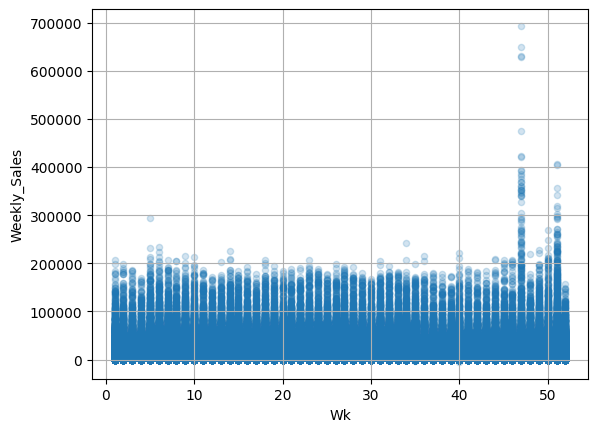

In [105]:
train.plot(kind="scatter", x="Wk", y="Weekly_Sales", grid=True,alpha=0.2)
plt.show(). #Setting the alpha option to 0.2 makes it much easier to visualize the places where there is a high density of data points

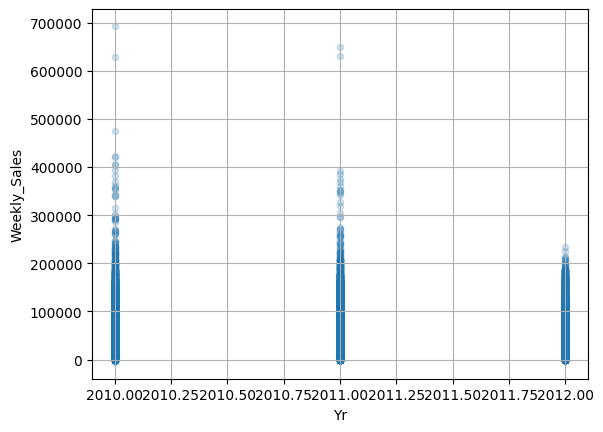

In [106]:
train.plot(kind="scatter", x="Yr", y="Weekly_Sales", grid=True, alpha=0.2)
plt.show()

In [110]:
corr_matrix = train.corr()
corr_matrix
corr_matrix["Weekly_Sales"].sort_values(ascending=False)


,Weekly_Sales
Weekly_Sales,1.000000
Dept,0.146602
Wk,0.030897
IsHoliday,0.012973
Date,0.002137
Yr,-0.008742
Store,-0.085551


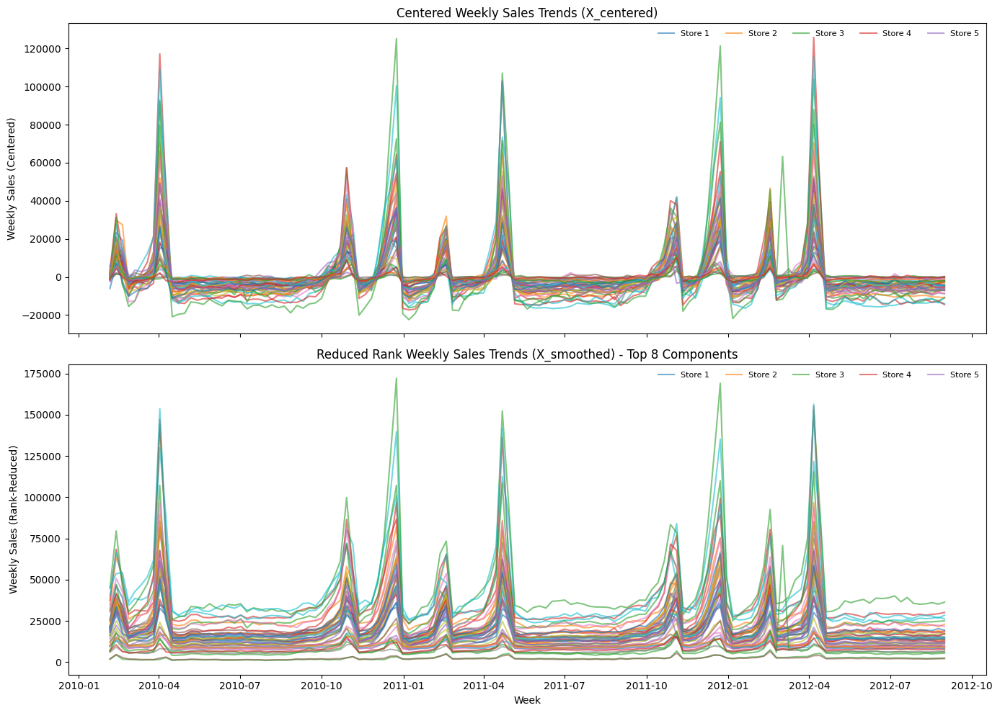

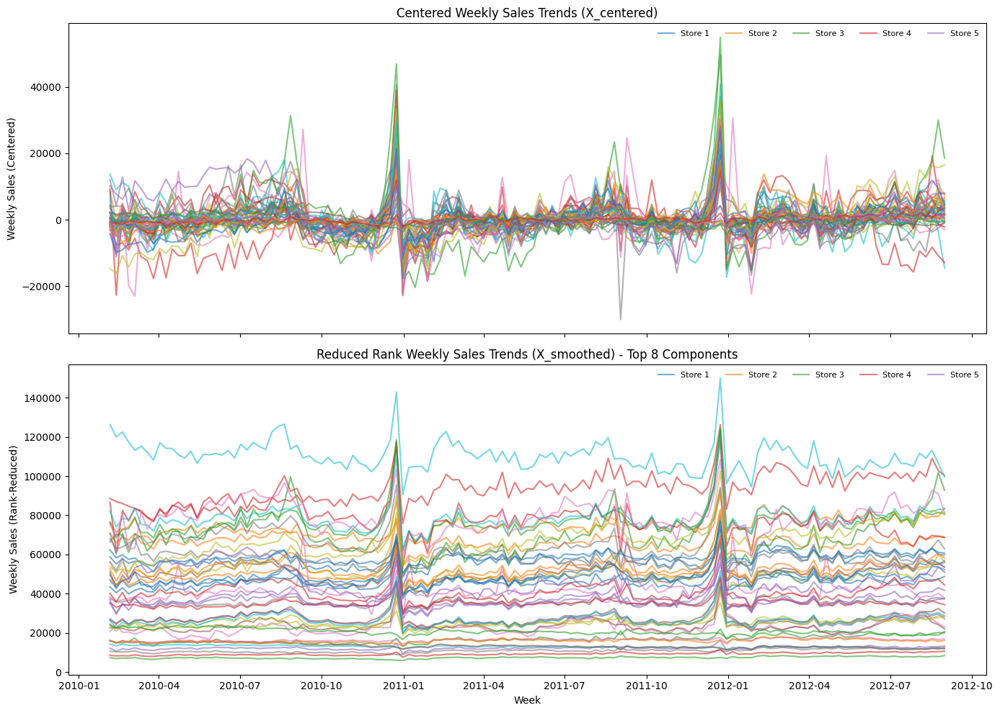

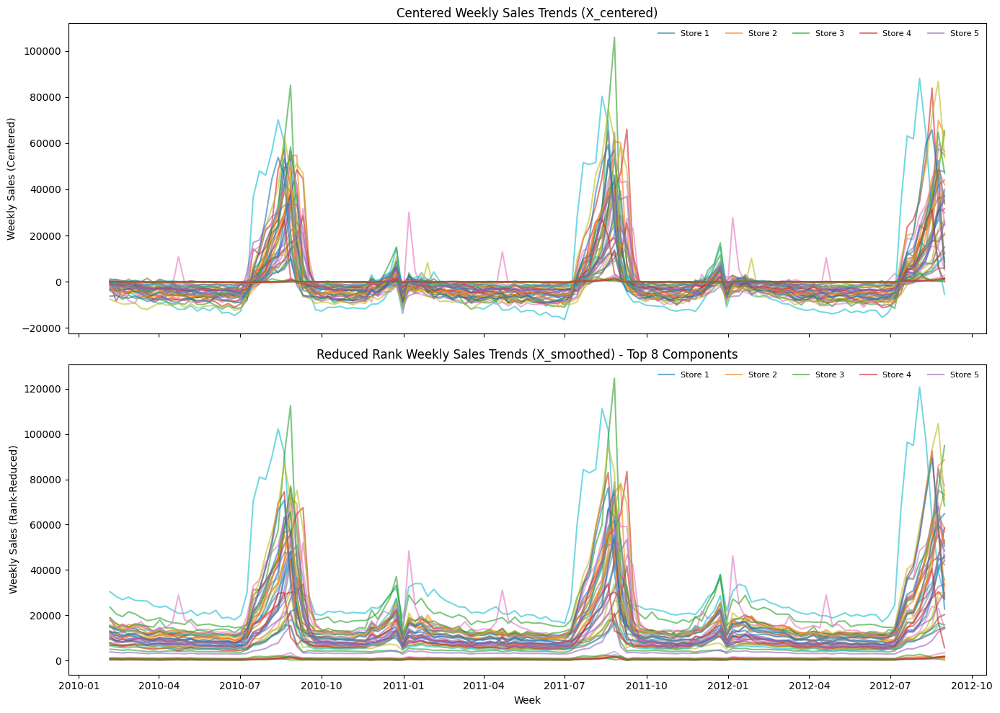

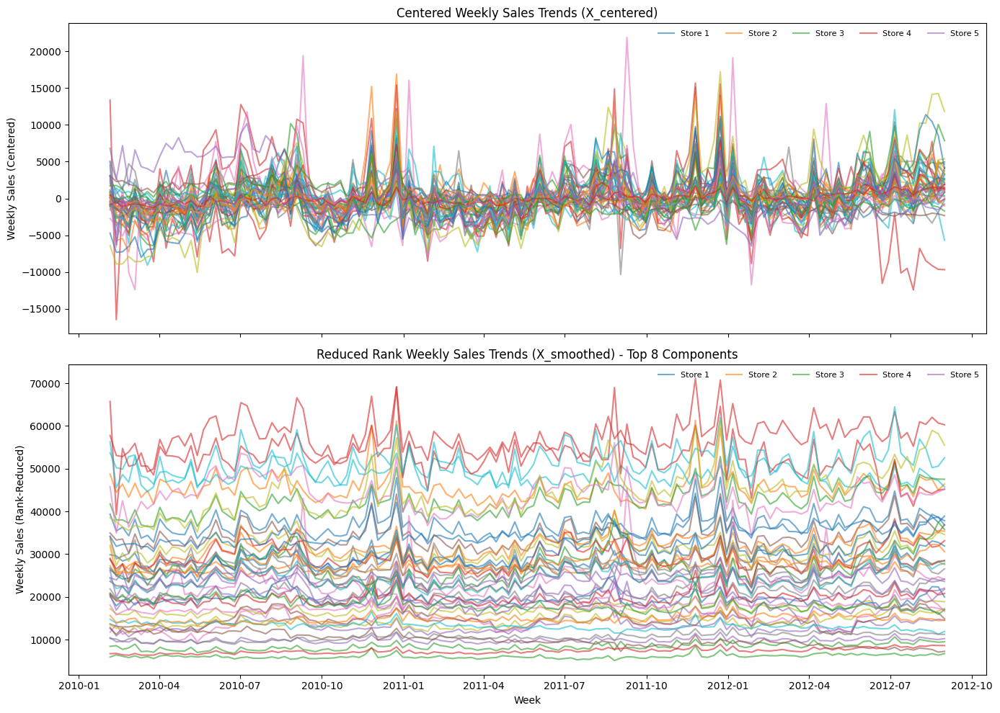

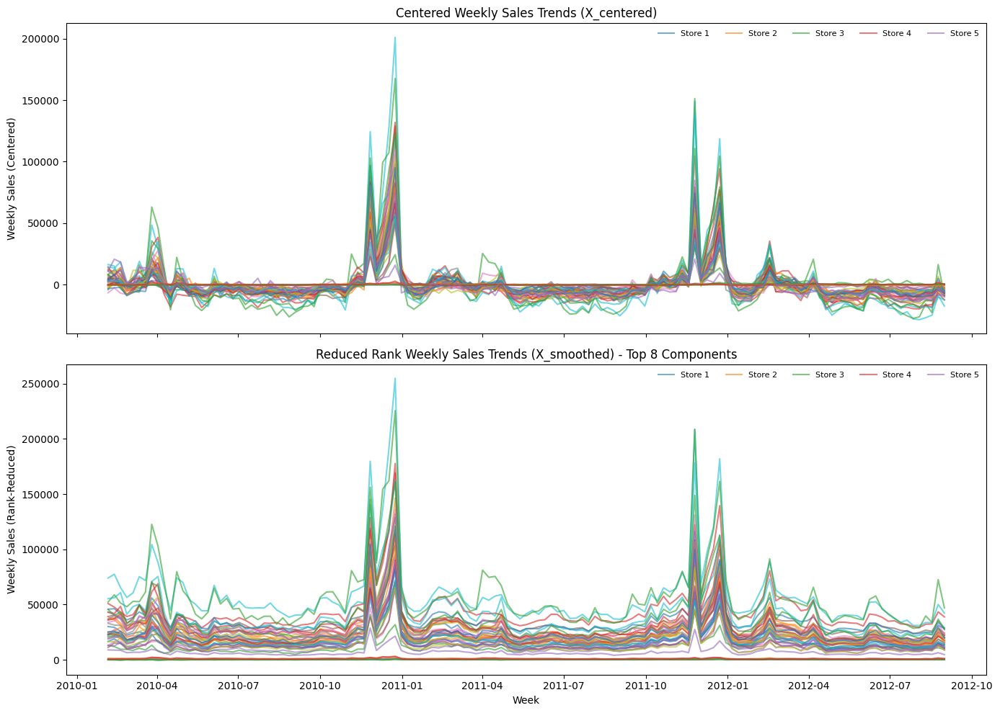

...

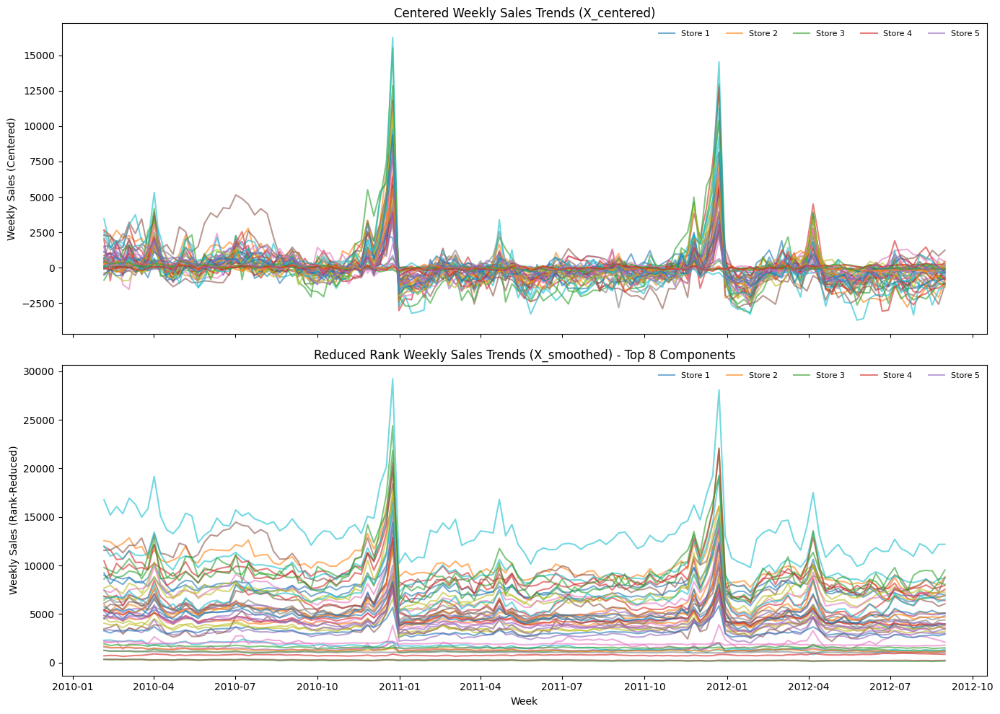

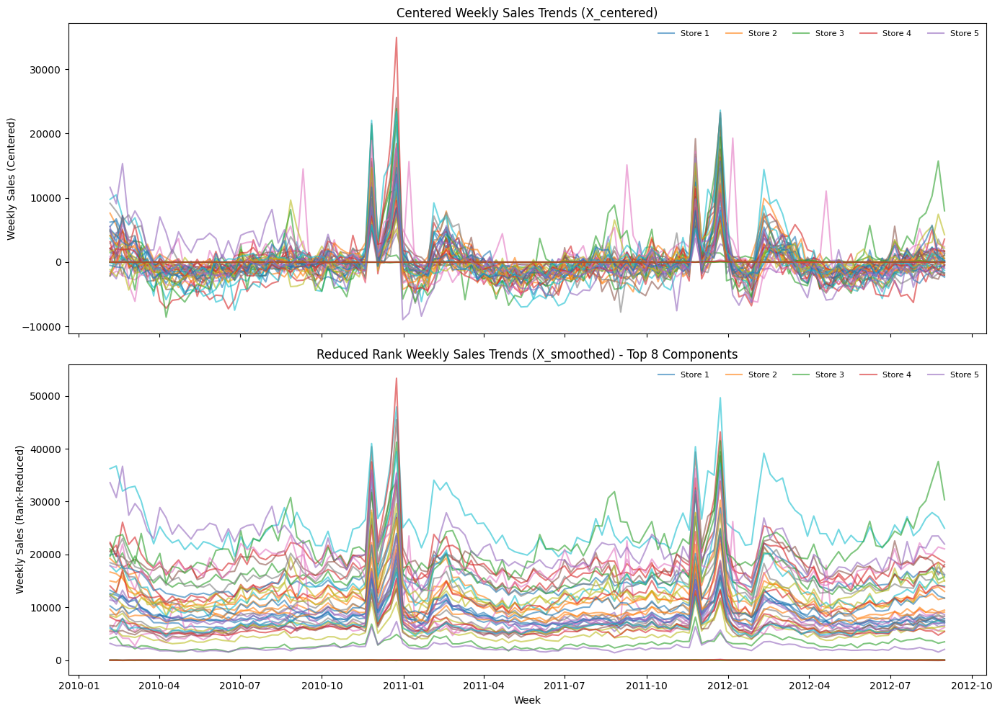

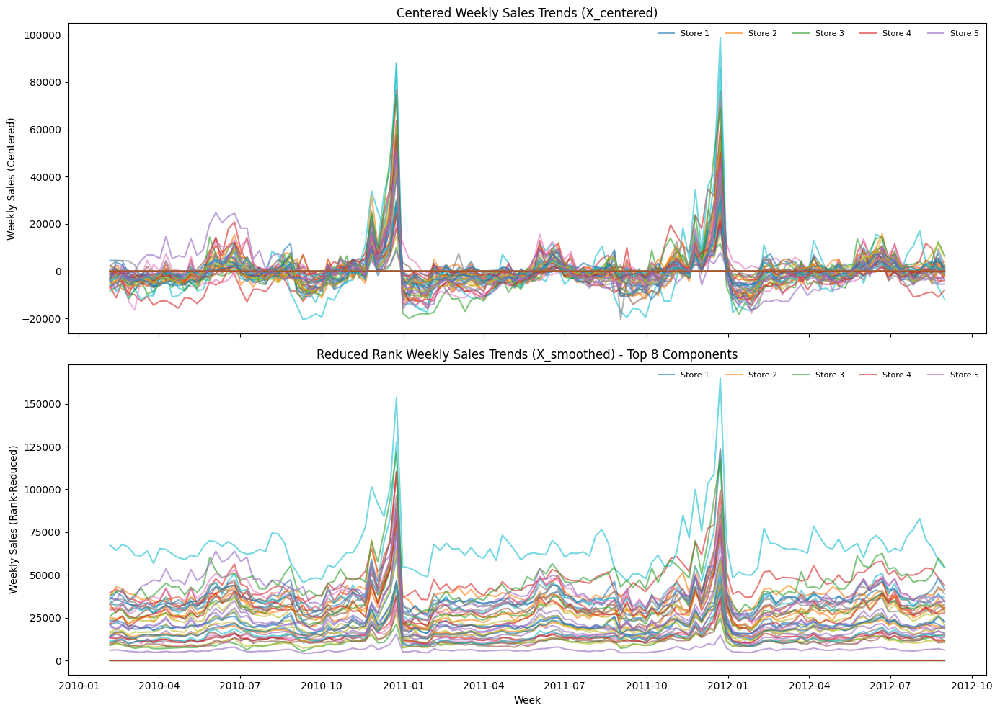

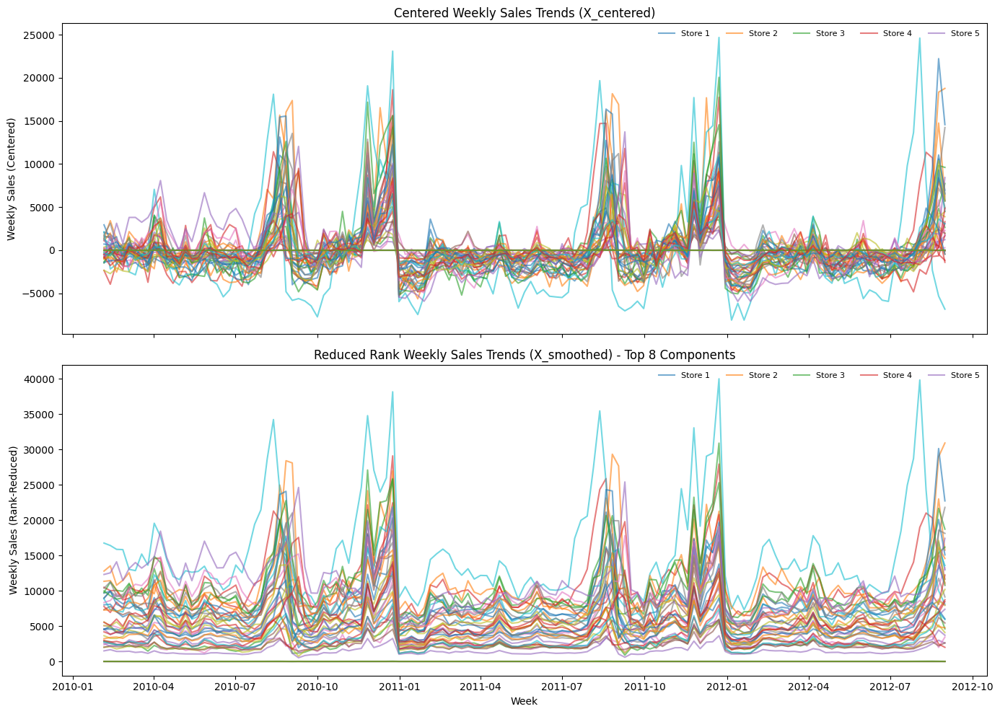

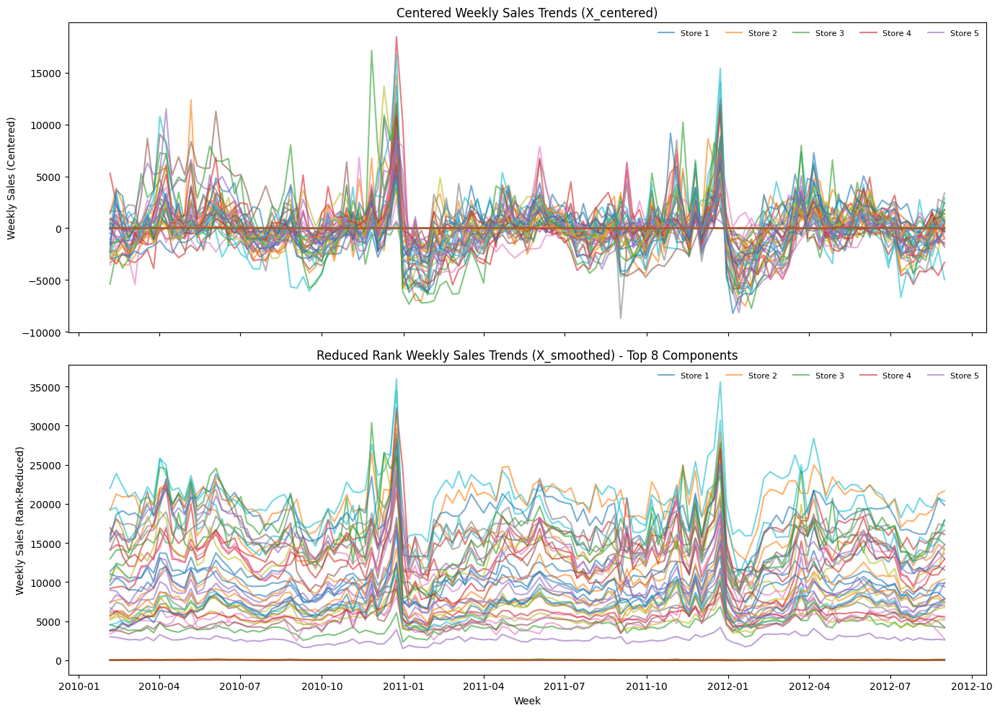

In [ ]:
import logging

# Configure logging
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(message)s',
    datefmt='%H:%M:%S'
)

 # Process each department
departments = train['Dept'].unique()

for dept_idx, department in enumerate(departments, 1):
    if dept_idx % 5 == 0:  # Log every 5th department
        logging.info(f"  Progress: {dept_idx}/{len(departments)} departments")

    filtered_train = train[train['Dept'] == department]
    # Left join with the test data
    test_pred = test.merge(tmp_train, on=['Dept', 'Store'], how='left')

    # Fill NaN values with 0 for the Weekly_Pred column
    filtered_train['Weekly_Pred'].fillna(0, inplace=True)


    selected_columns = filtered_train[['Store', 'Date', 'Weekly_Sales']]

    # Create pivot table and perform SVD
    X_pivot = selected_columns.pivot(index='Store', columns='Date',
                                  values='Weekly_Sales').fillna(0)
    X_matrix = X_pivot.values
    store_mean = X_matrix.mean(axis=1, keepdims=True)
    X_centered = X_matrix - store_mean

    # SVD computation
    U, D, Vt = np.linalg.svd(X_centered, full_matrices=False)
    n_comp = 8
    D_tilda = np.zeros_like(D)
    D_tilda[:n_comp] = D[:n_comp]
    X_tilda = U[:, :n_comp] @ np.diag(D_tilda[:n_comp]) @ Vt[:n_comp, :]
    X_smoothed = X_tilda + store_mean




    # Plotting the centered and reduced-rank weekly sales trends for each store
    fig, axes = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

    # Plot X_centered (Centered Data)
    for store in range(X_centered.shape[0]):
        axes[0].plot(X_pivot.columns, X_centered[store, :], label=f'Store {store+1}' if store < 5 else "", alpha=0.6)
    axes[0].set_title("Centered Weekly Sales Trends (X_centered)")
    axes[0].set_ylabel("Weekly Sales (Centered)")
    axes[0].legend(loc='upper right', ncol=5, fontsize=8, frameon=False)

    # Plot X_delta (Rank-Reduced Data)
    for store in range(X_smoothed.shape[0]):
        axes[1].plot(X_pivot.columns, X_smoothed[store, :], label=f'Store {store+1}' if store < 5 else "", alpha=0.6)
    axes[1].set_title(f"Reduced Rank Weekly Sales Trends (X_smoothed) - Top {n_comp} Components")
    axes[1].set_xlabel("Week")
    axes[1].set_ylabel("Weekly Sales (Rank-Reduced)")
    axes[1].legend(loc='upper right', ncol=5, fontsize=8, frameon=False)

    plt.tight_layout()
    plt.show()




In [89]:
test=preprocess(test)

# change the index of our dataframe to the Date column:

In [225]:
train = train.set_index('Date')
train.tail(3)

,Store,Dept,Weekly_Sales,IsHoliday,Wk,Yr,Month
Date,,,,,,,
2012-08-17,45,98,500.16,0,33,2012,8
2012-08-24,45,98,415.40,0,34,2012,8
2012-08-31,45,98,346.04,0,35,2012,8


# Visualization

(array([14610., 14700., 14791., 14883., 14975., 15065., 15156., 15248.,
        15340., 15431., 15522., 15614.]),
 [Text(14610.0, 0, '2010-01'),
  Text(14700.0, 0, '2010-04'),
  Text(14791.0, 0, '2010-07'),
  Text(14883.0, 0, '2010-10'),
  Text(14975.0, 0, '2011-01'),
  Text(15065.0, 0, '2011-04'),
  Text(15156.0, 0, '2011-07'),
  Text(15248.0, 0, '2011-10'),
  Text(15340.0, 0, '2012-01'),
  Text(15431.0, 0, '2012-04'),
  Text(15522.0, 0, '2012-07'),
  Text(15614.0, 0, '2012-10')])

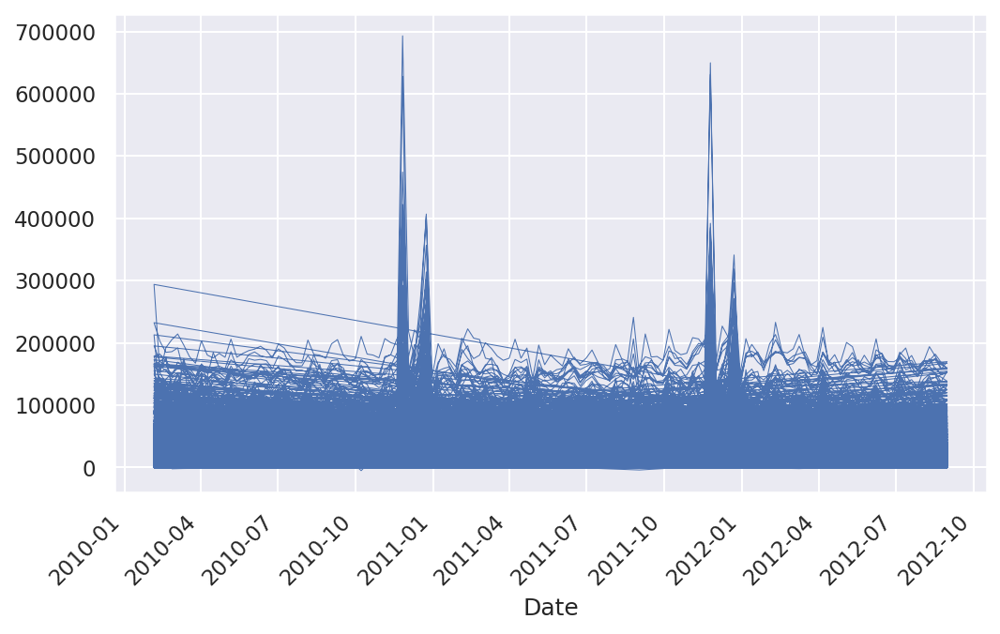

In [226]:
# # Generate a line plot of the full time series  # if the Date as index
train['Weekly_Sales'].plot(linewidth=0.5)
plt.xticks(rotation=45)  # Rotate dates for better readability




In [272]:
# Specific Year
ax = train.loc['2011', 'Weekly_Sales'].plot(marker='o',linestyle='')
ax.set_ylabel('Weekly_Sales');

KeyError: '2011'

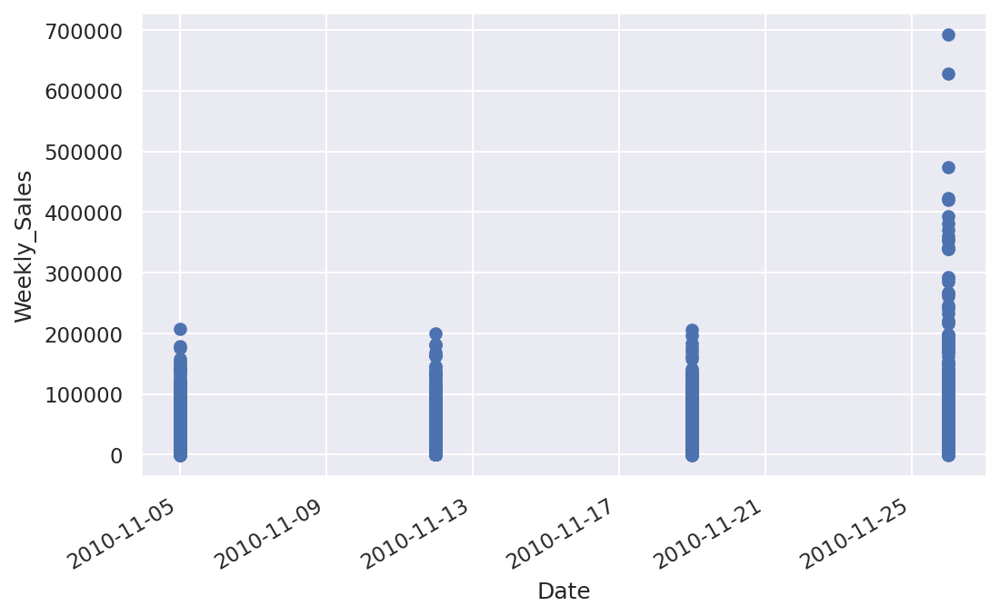

In [227]:
# By Month
ax = train.loc['2010-11', 'Weekly_Sales'].plot(marker='o', linestyle='')
ax.set_ylabel('Weekly_Sales');

<ipython-input-48-de5f8e506fed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()


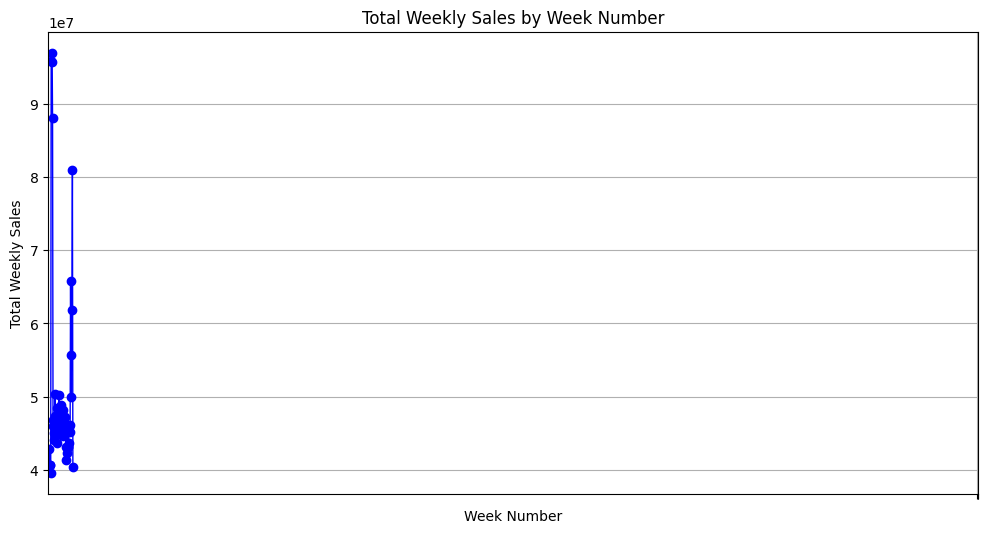

<ipython-input-48-de5f8e506fed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()


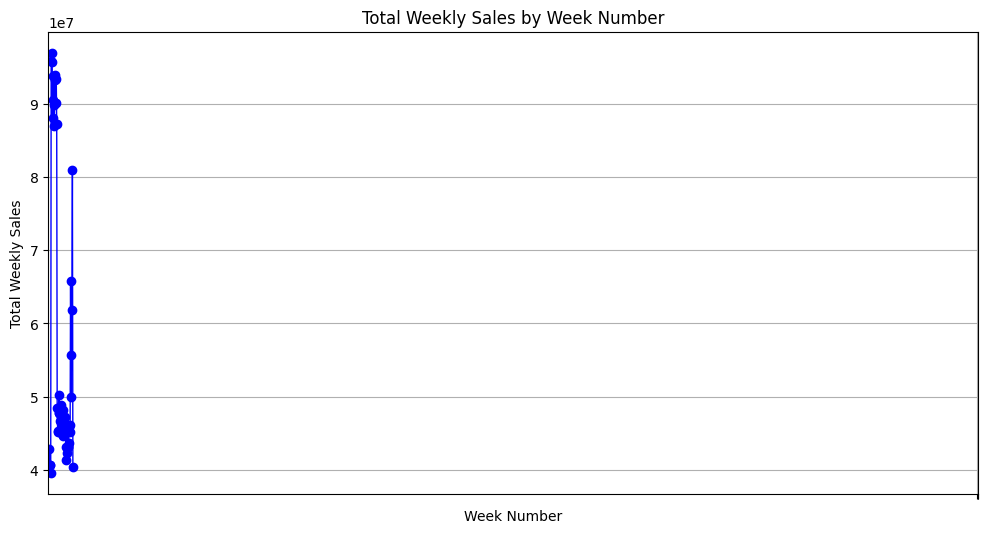

<ipython-input-48-de5f8e506fed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()


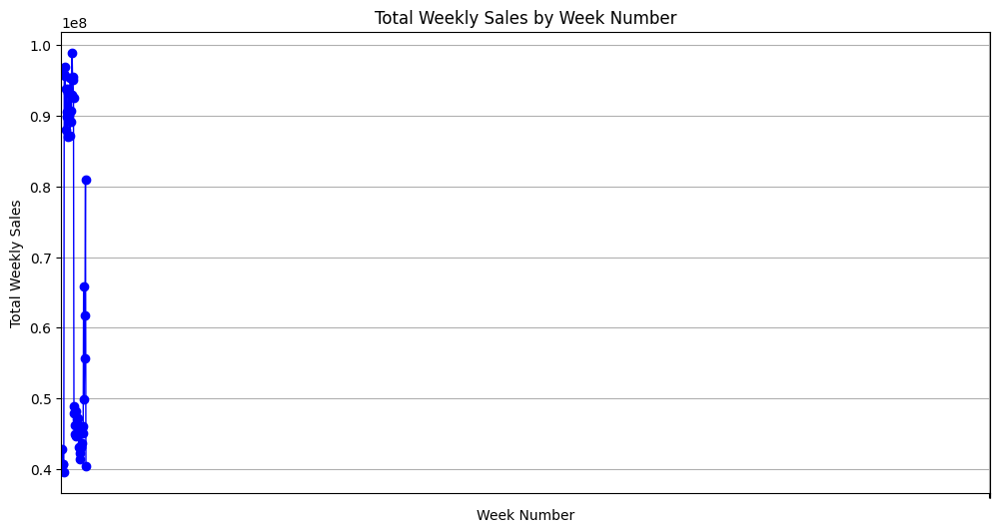

<ipython-input-48-de5f8e506fed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()


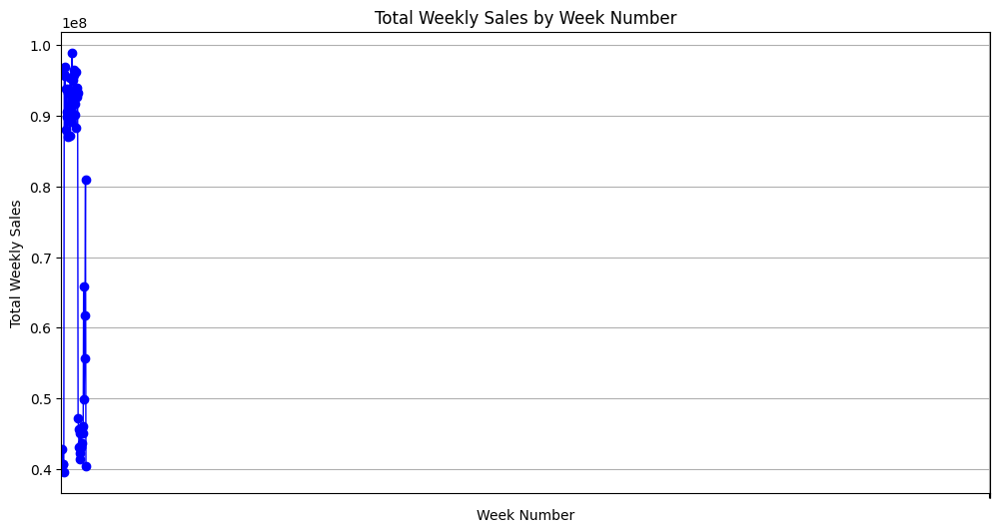

<ipython-input-48-de5f8e506fed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()


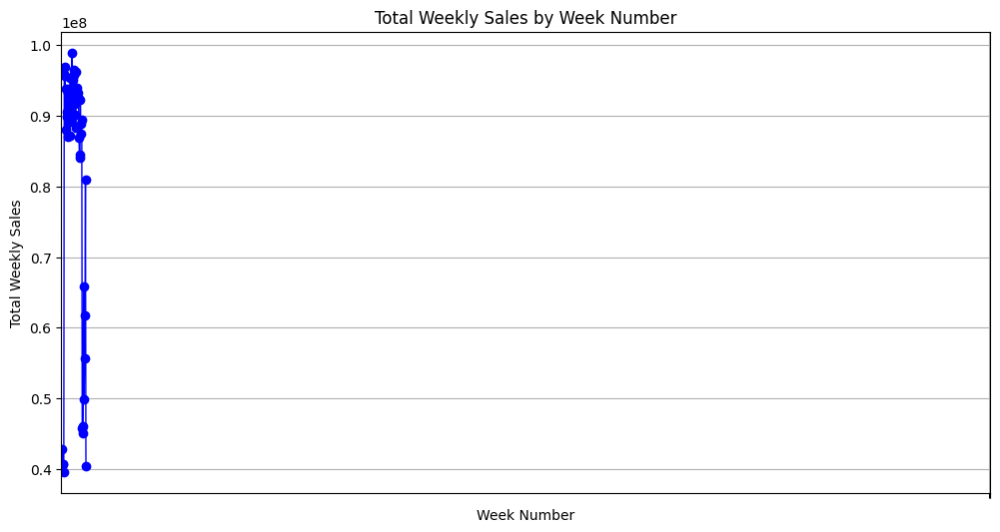

<ipython-input-48-de5f8e506fed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()


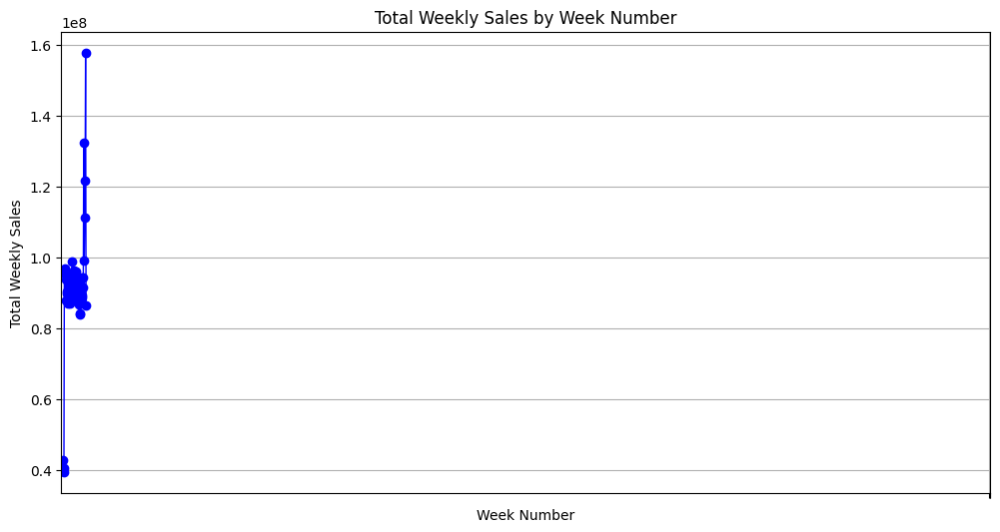

<ipython-input-48-de5f8e506fed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()


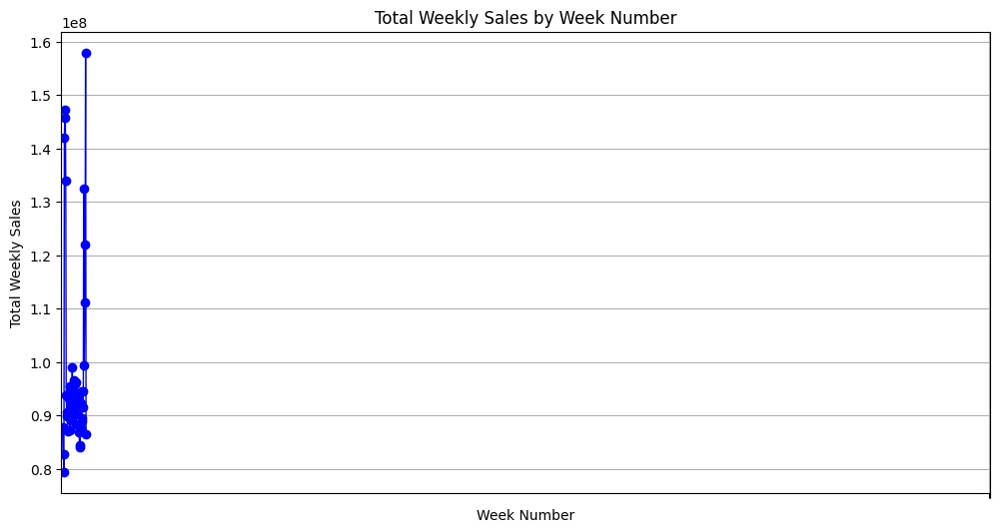

<ipython-input-48-de5f8e506fed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()


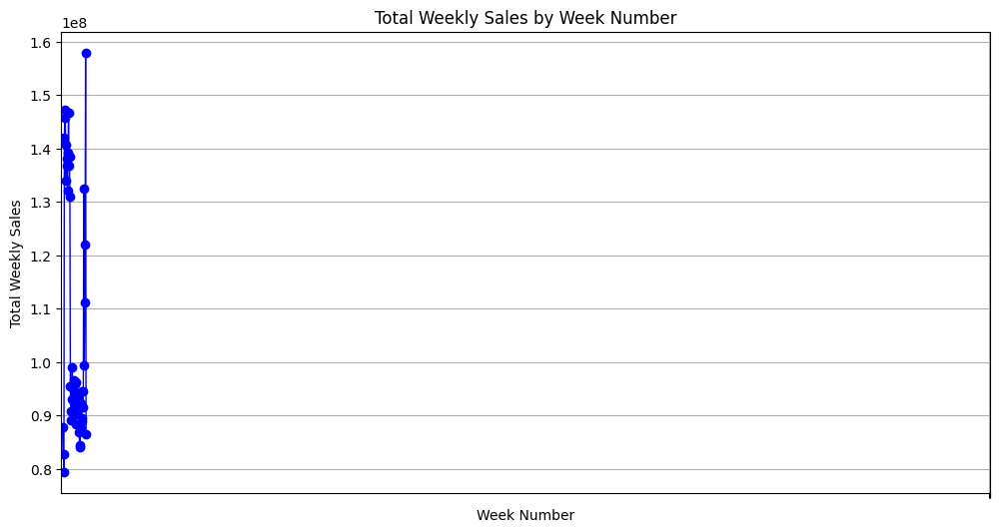

<ipython-input-48-de5f8e506fed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()


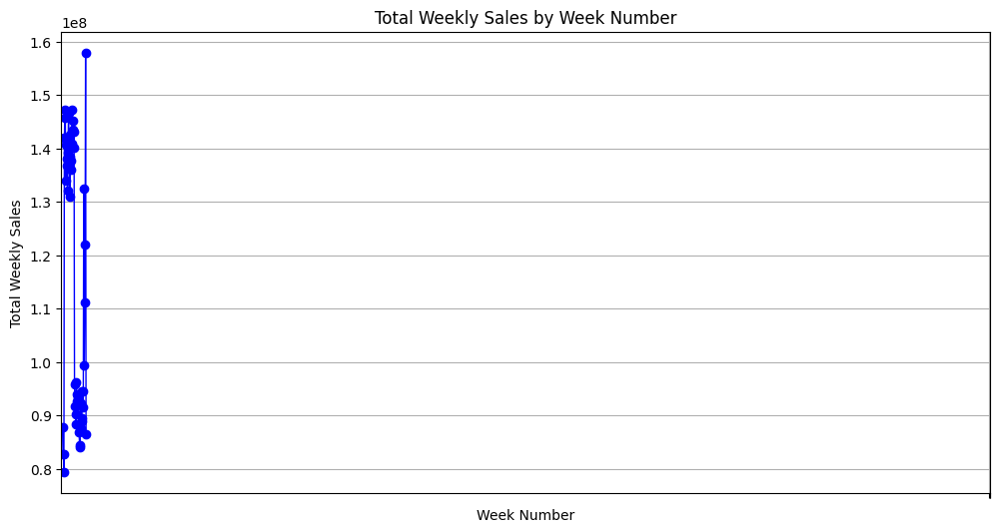

<ipython-input-48-de5f8e506fed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()


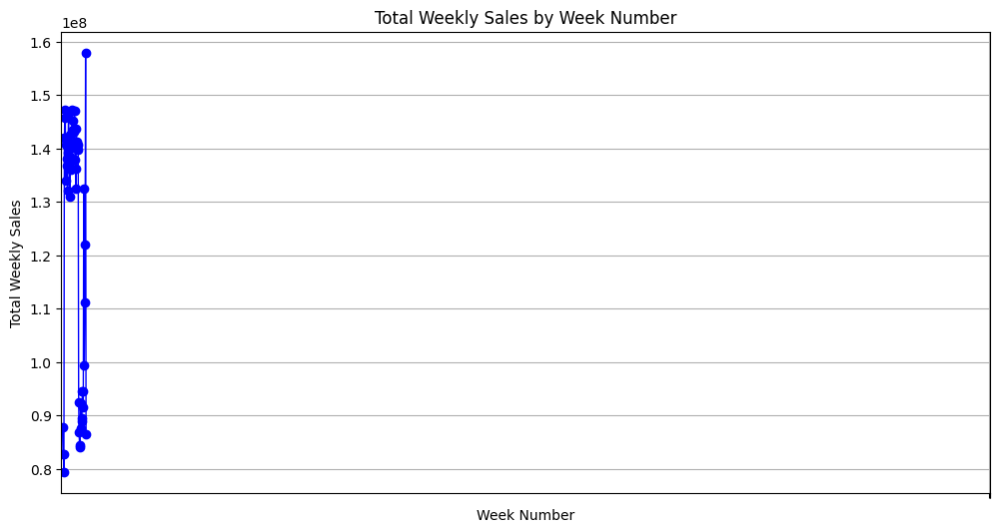

In [48]:
#Plot WS vs Wk
for i in range(10):
    train = pd.read_csv(f'{DATA_DIR}/fold_{i+1}/train.csv')
    train=preprocess(train)
    # Group by 'Wk' and sum the 'Weekly_Sales'
    weekly_sales = train.groupby('Wk')['Weekly_Sales'].sum()
    # Plotting Weekly Sales against Week
    plt.figure(figsize=(12, 6))
    weekly_sales.plot(marker='o', linestyle='-', linewidth=1, color='b')  # Using line with markers

    # Customize the plot
    plt.title('Total Weekly Sales by Week Number')
    plt.xlabel('Week Number')
    plt.ylabel('Total Weekly Sales')
    plt.xticks(range(1, 53))  # Assuming 52 weeks in the year
    plt.grid()
    plt.show()

<ipython-input-54-257e72e201ba>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()


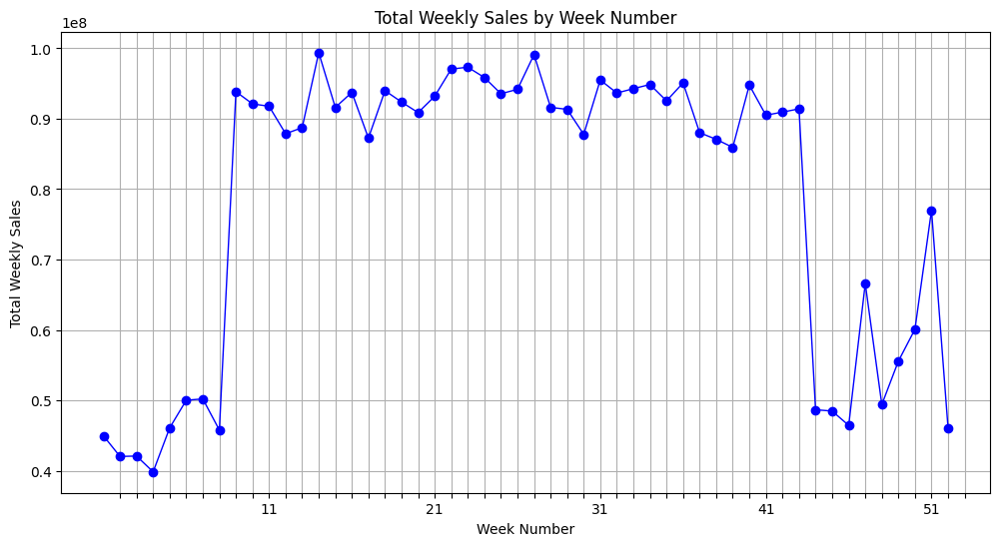

<ipython-input-54-257e72e201ba>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()


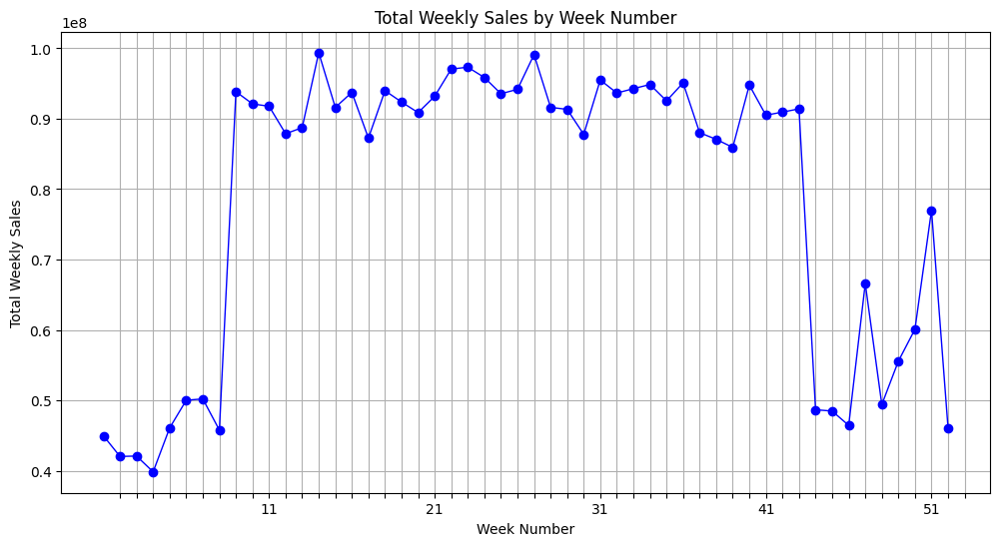

<ipython-input-54-257e72e201ba>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()


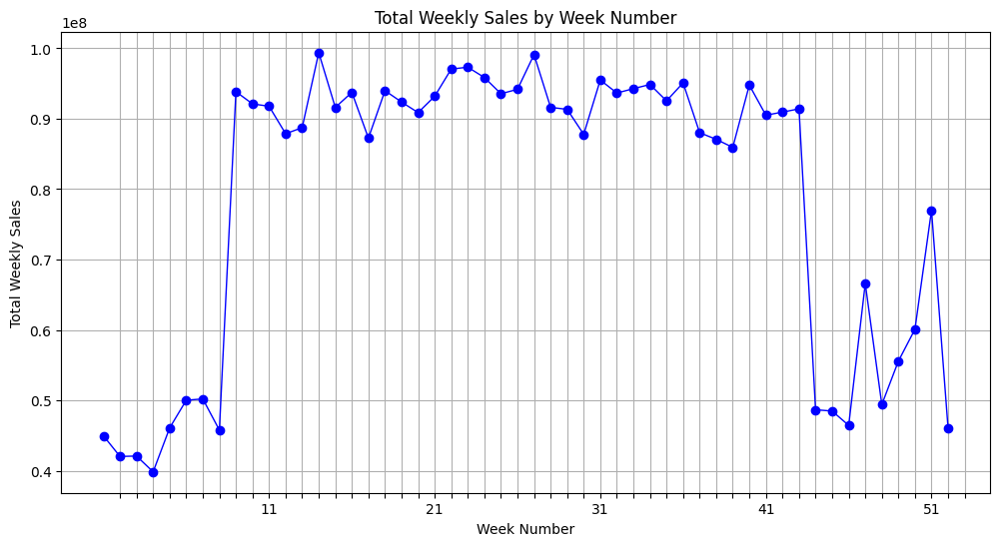

<ipython-input-54-257e72e201ba>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()


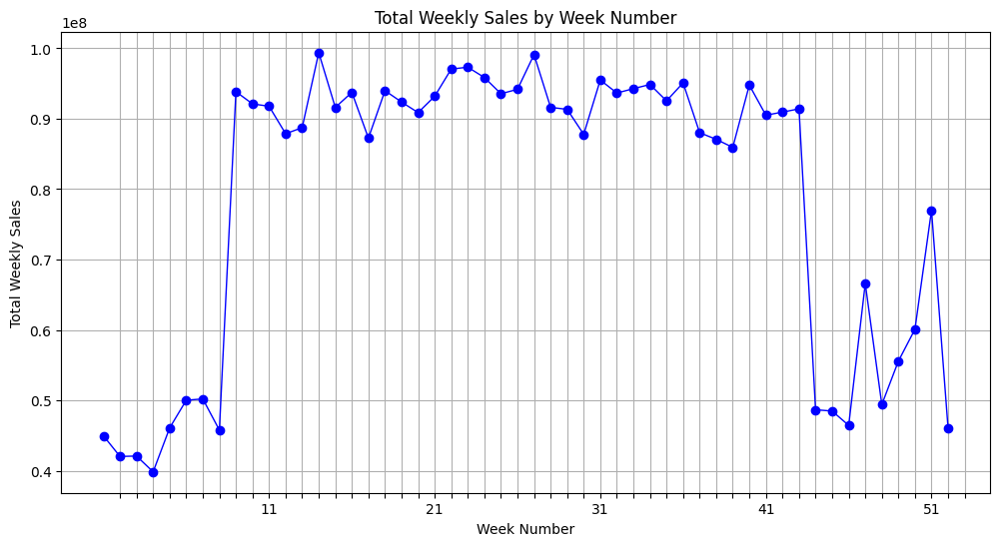

<ipython-input-54-257e72e201ba>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()


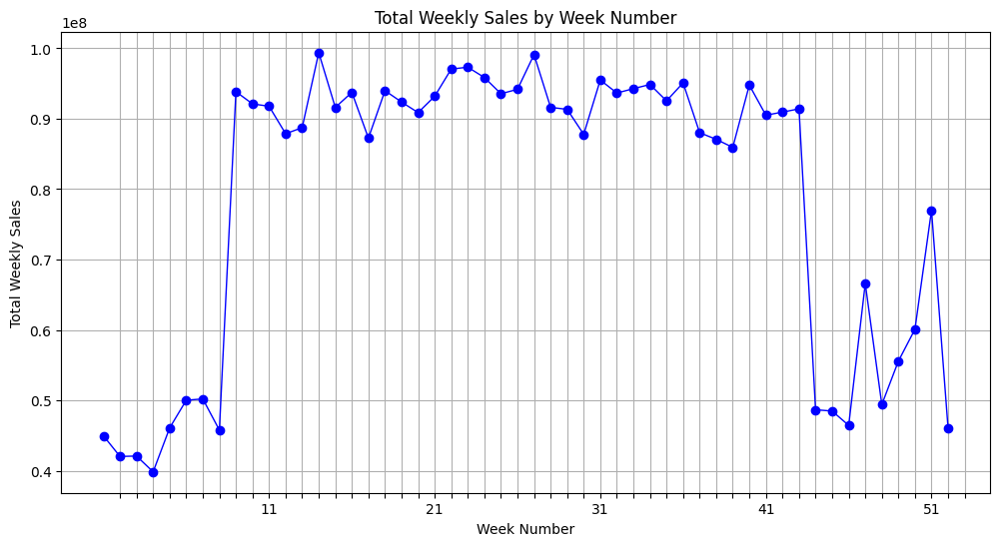

<ipython-input-54-257e72e201ba>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()


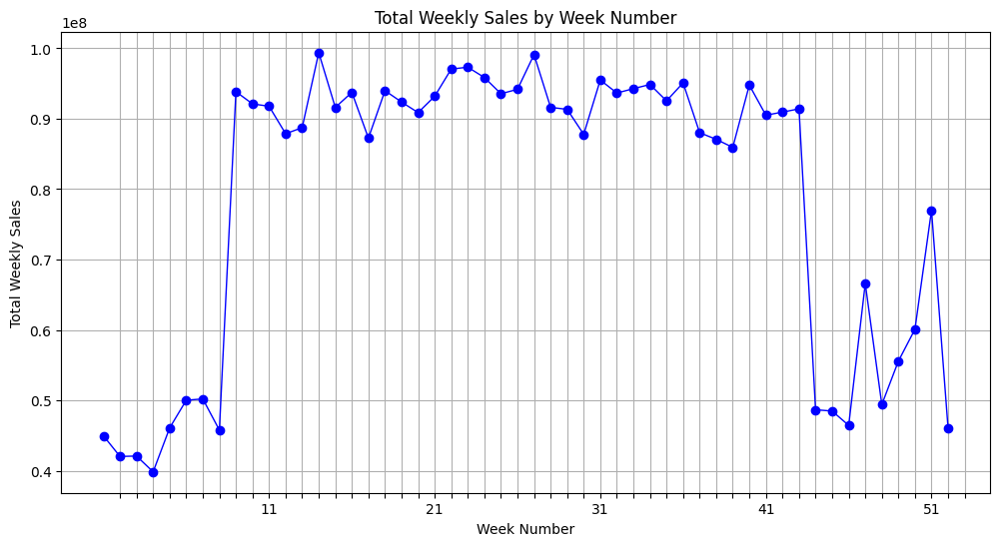

<ipython-input-54-257e72e201ba>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()


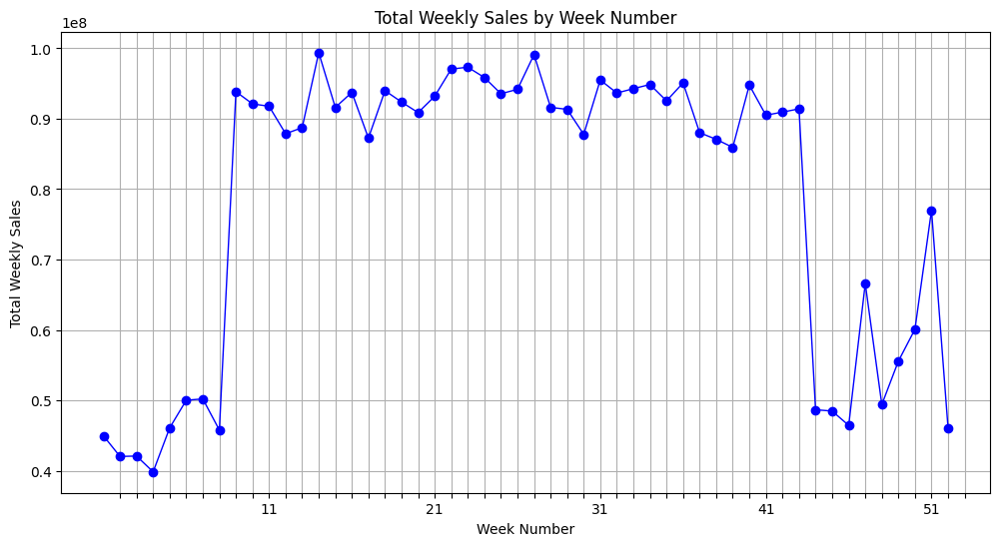

<ipython-input-54-257e72e201ba>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()


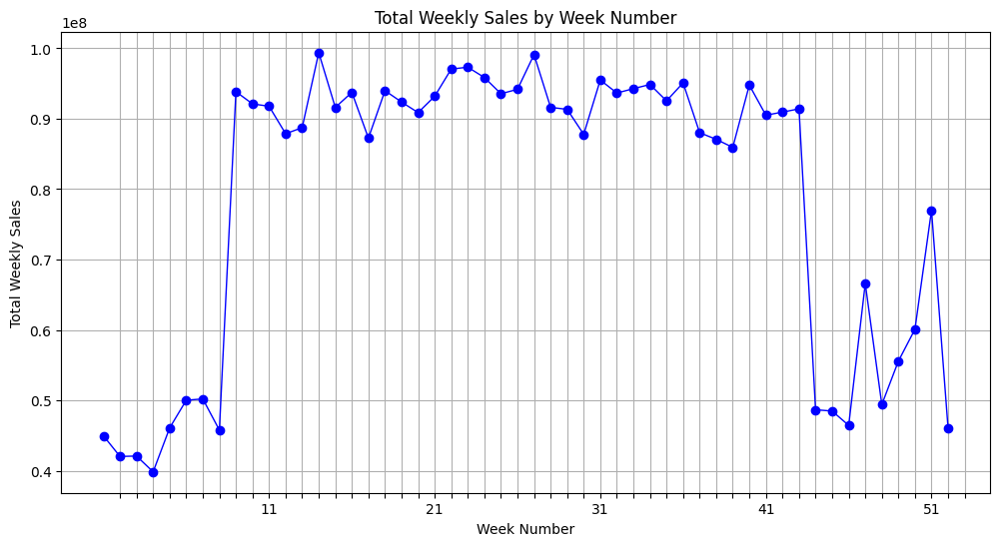

<ipython-input-54-257e72e201ba>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()


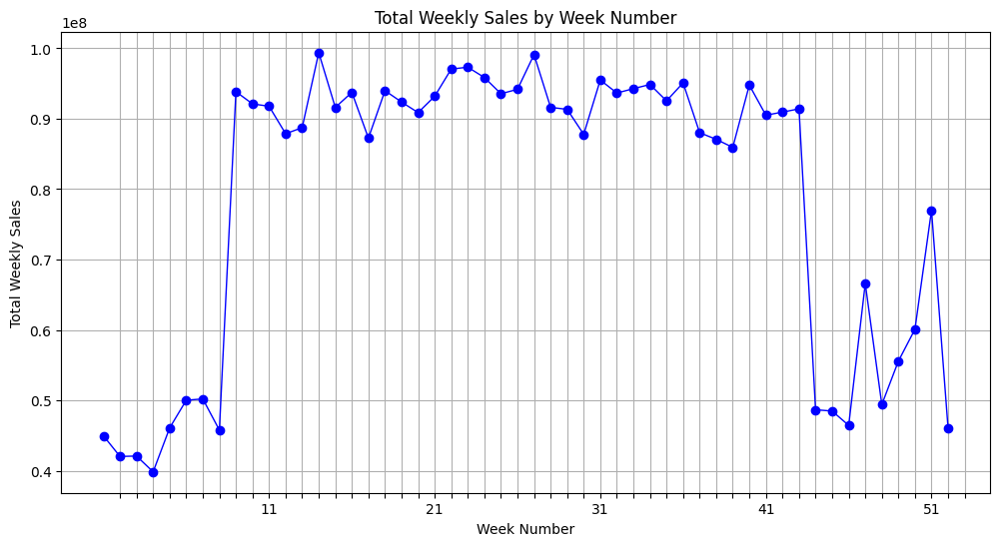

<ipython-input-54-257e72e201ba>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()


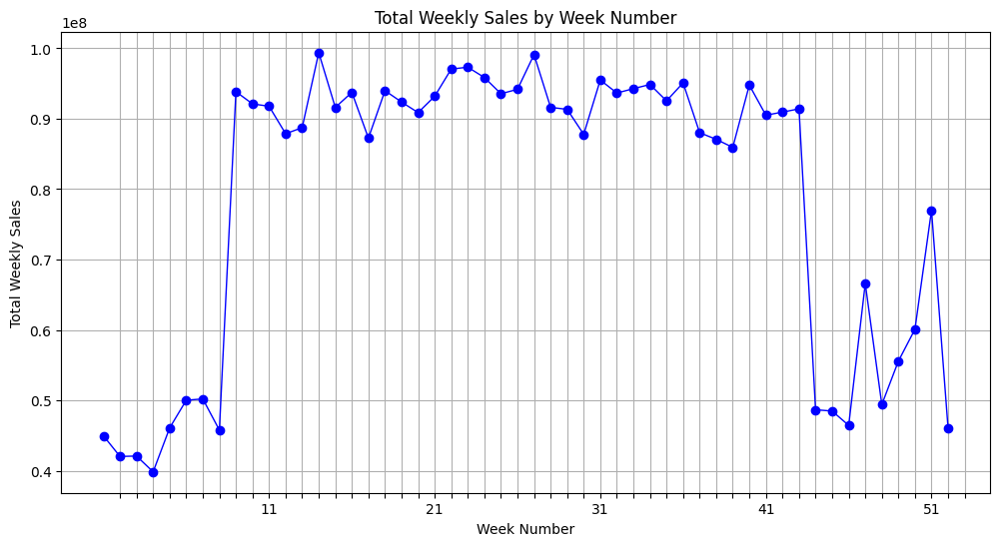

In [54]:
##Year
#Plot WS vs Wk
for i in range(10):
    test = pd.read_csv(f'{DATA_DIR}/test_with_label.csv')
    test=preprocess(test)
    # Group by 'Wk' and sum the 'Weekly_Sales'
    weekly_sales = test.groupby('Wk')['Weekly_Sales'].sum()
    # Plotting Weekly Sales against Week
    plt.figure(figsize=(12, 6))
    weekly_sales.plot(marker='o', linestyle='-', linewidth=1, color='b')  # Using line with markers

    # Customize the plot
    plt.title('Total Weekly Sales by Week Number')
    plt.xlabel('Week Number')
    plt.ylabel('Total Weekly Sales')
    plt.xticks(range(1, 53))  # Assuming 52 weeks in the year
    plt.grid()
    plt.show()

In [ ]:
for i in range(10):
    test_with_label = pd.read_csv(f'{DATA_DIR}/test_with_label.csv')
    test_with_label=preprocess(test_with_label)


    # Group by 'Yr' and sum the 'Weekly_Sales'
    yearly_sales = train.groupby('Yr')['Weekly_Sales'].sum()
    # Plotting Weekly Sales against Year
    plt.figure(figsize=(10, 6))
    yearly_sales.plot(kind='bar', color='b')  # You can also use line plot with .plot() if desired

    # Customize the plot
    plt.title('Total Weekly Sales by Year')
    plt.xlabel('Year')
    plt.ylabel('Total Weekly Sales')
    plt.xticks(rotation=0)  # Rotate x-axis labels if necessary
    plt.grid(axis='y')  # Add gridlines to the y-axis
    plt.show()

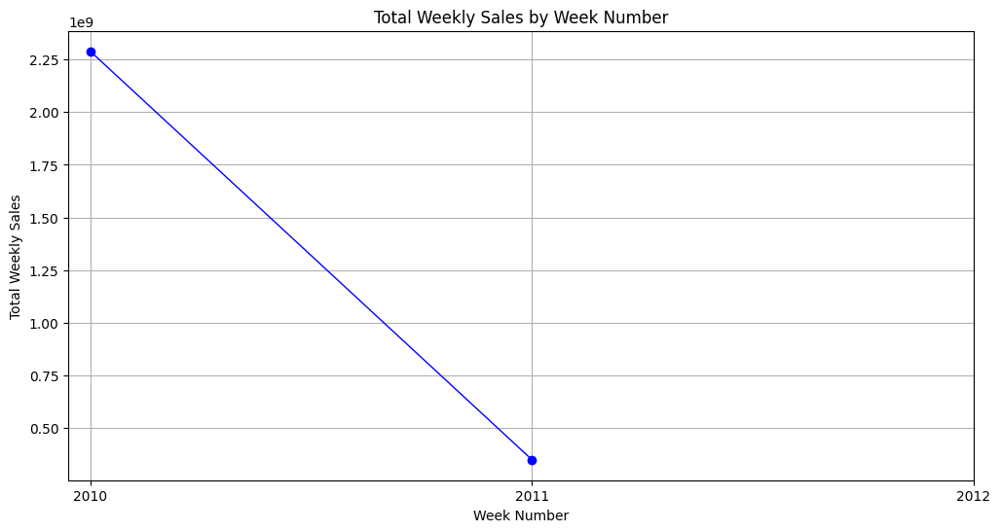

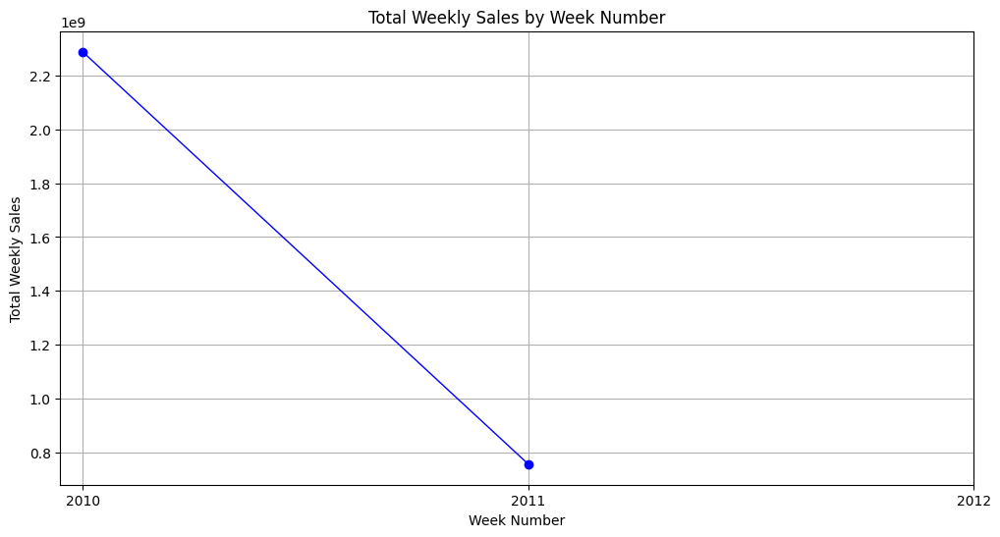

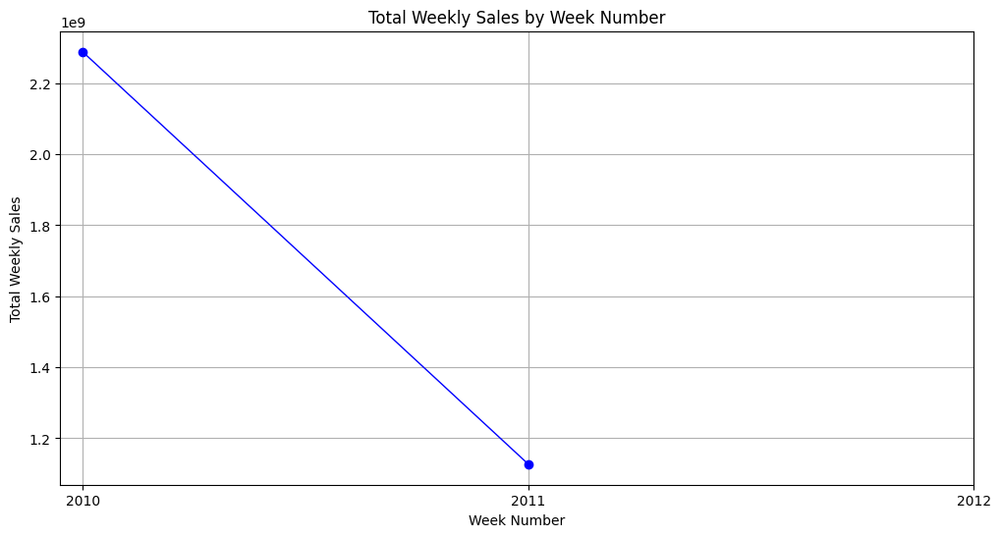

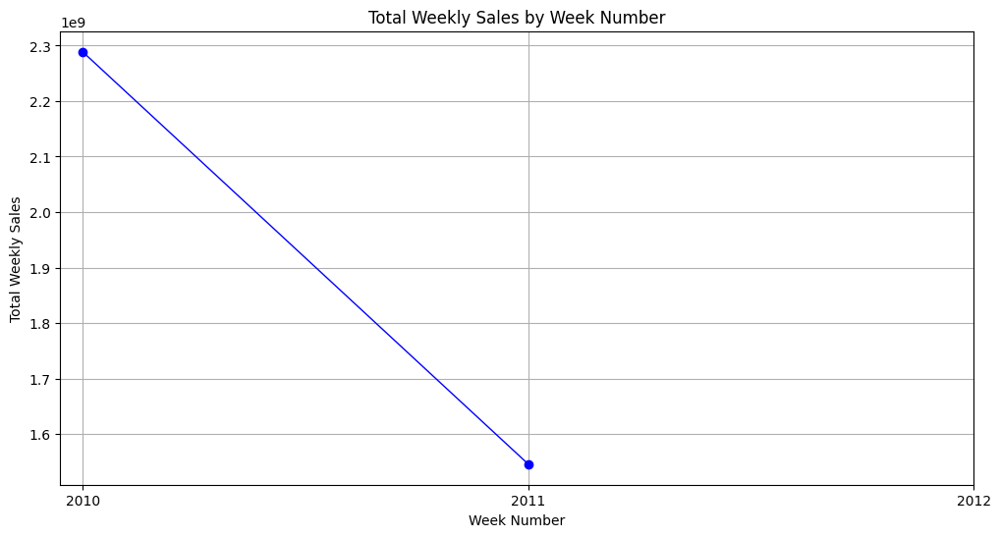

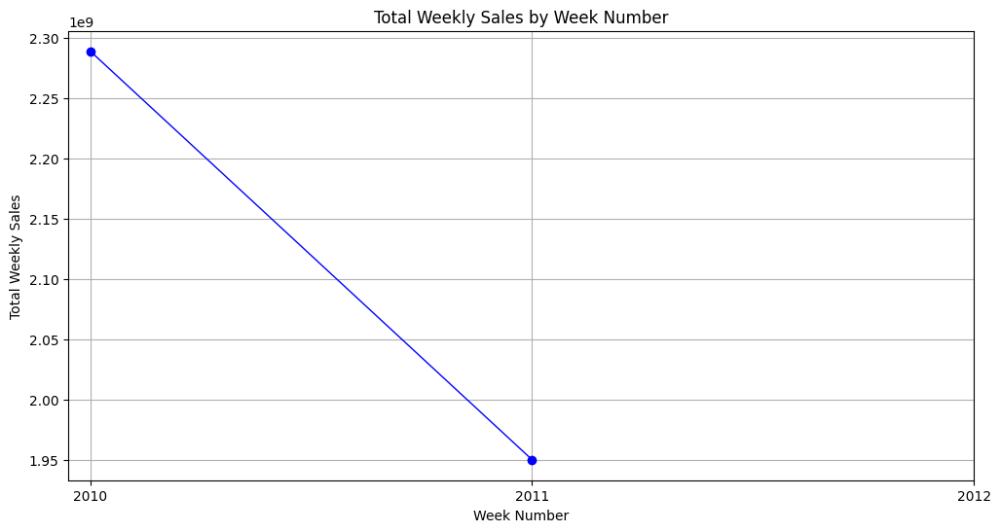

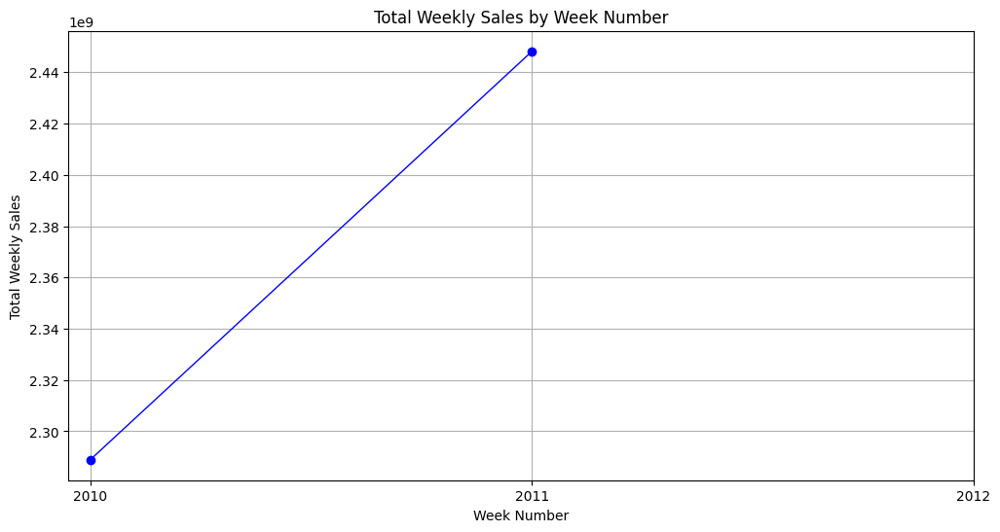

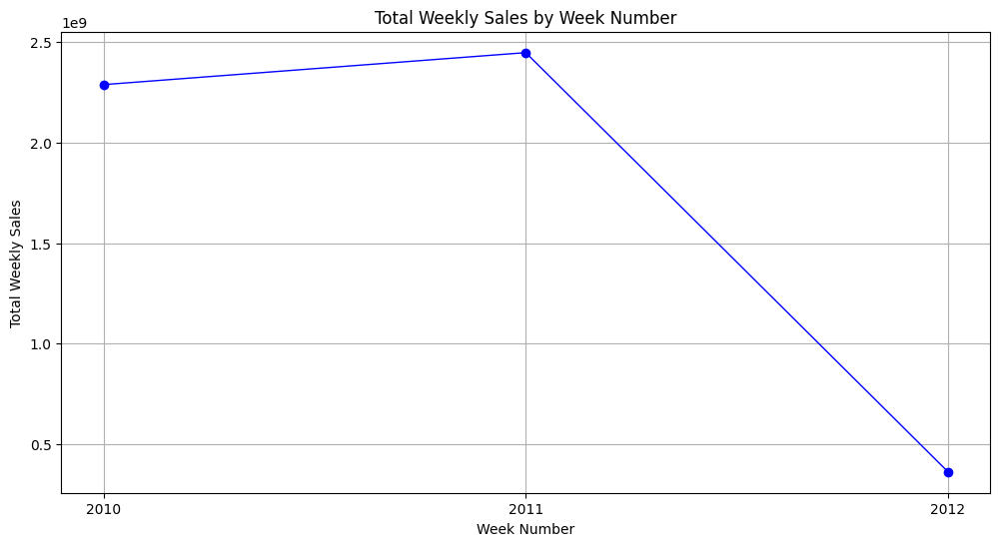

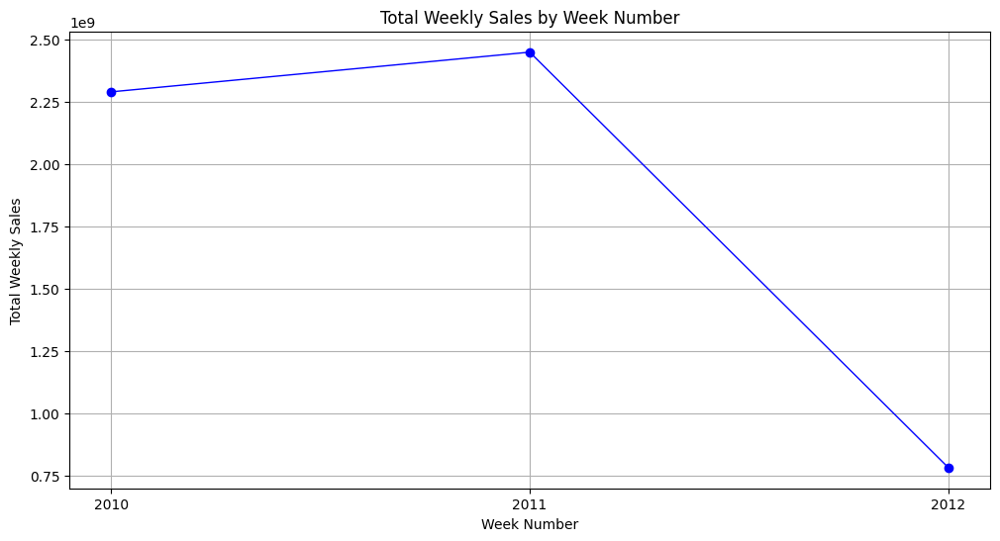

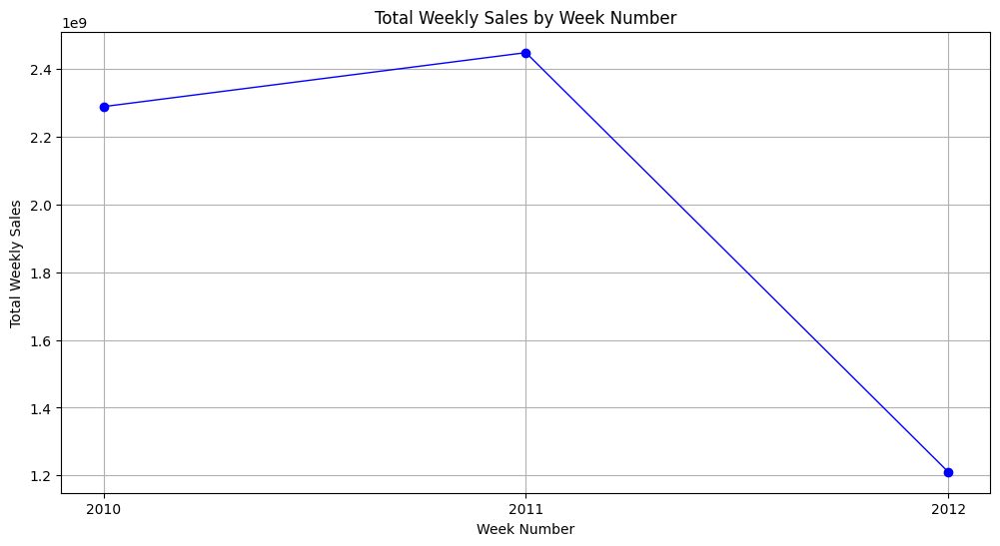

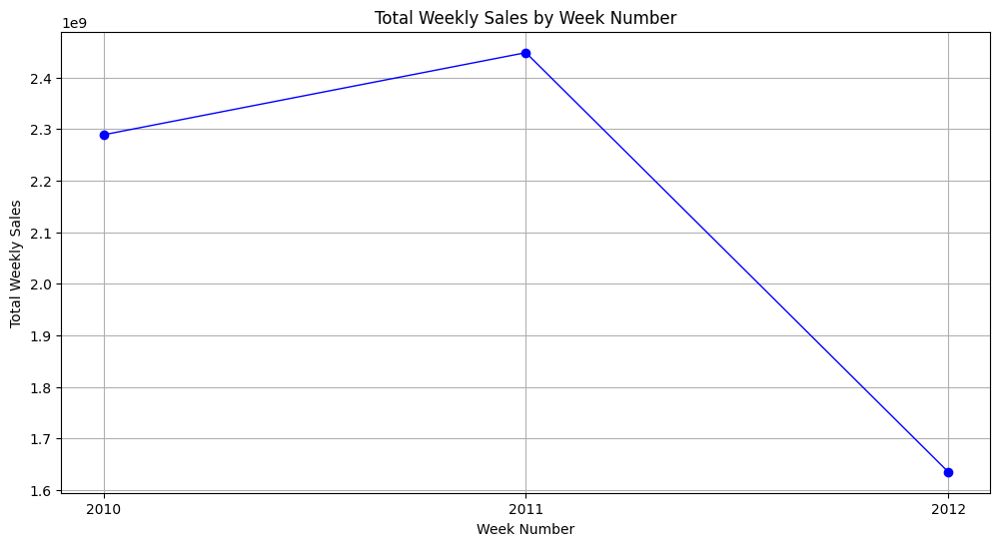

In [30]:
for i in range(10):
    train = pd.read_csv(f'{DATA_DIR}/fold_{i+1}/train.csv')
    train=preprocess(train)
    weekly_sales = train.groupby('Yr')['Weekly_Sales'].sum()
    # Plotting Weekly Sales against Week
    plt.figure(figsize=(12, 6))
    weekly_sales.plot(marker='o', linestyle='-', linewidth=1, color='b')  # Using line with markers

    # Customize the plot
    plt.title('Total Weekly Sales by Week Number')
    plt.xlabel('Week Number')
    plt.ylabel('Total Weekly Sales')
    plt.xticks(range(2010, 2013))  # Assuming 52 weeks in the year
    plt.grid()
    plt.show()

In [20]:
!pip install pmdarima

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 20.3 MB/s eta 0:00:00


## Time Series Model

In [44]:
train = pd.read_csv(f'{DATA_DIR}/fold_10/train.csv')
test = pd.read_csv(f'{DATA_DIR}/fold_10/train.csv')


train["Date"] = pd.to_datetime(train["Date"]) #changing data to datetime for decomposing
train.set_index('Date', inplace=True) #seting date as index


In [46]:
test["Date"] = pd.to_datetime(test["Date"]) #changing data to datetime for decomposing
test.set_index('Date', inplace=True) #seting date as index

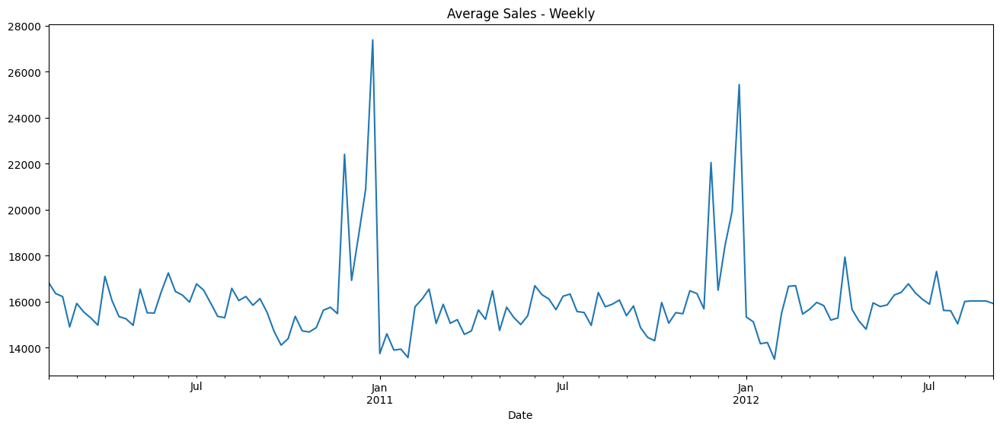

In [32]:
df_week = train.resample('W').mean() #resample data as weekly
plt.figure(figsize=(16,6))
df_week['Weekly_Sales'].plot()
plt.title('Average Sales - Weekly')
plt.show()

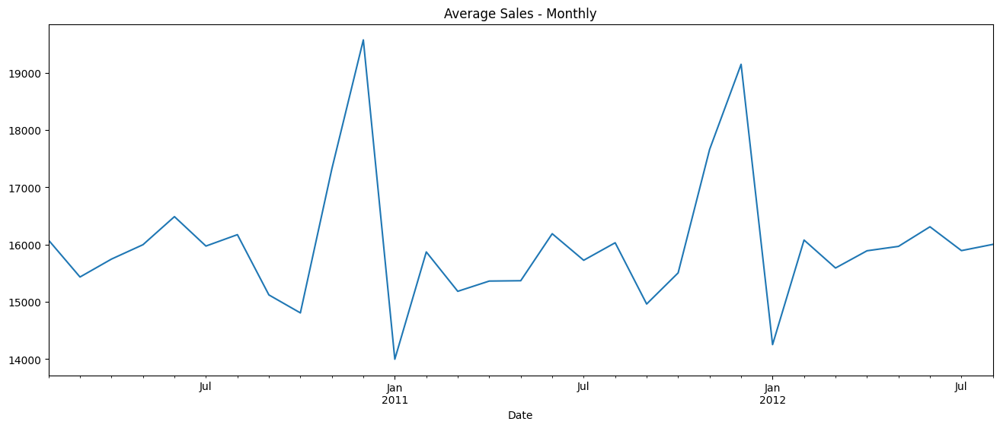

In [33]:

df_month = train.resample('MS').mean() # resampling as monthly
plt.figure(figsize=(16,6))
df_month['Weekly_Sales'].plot()
plt.title('Average Sales - Monthly')
plt.show()

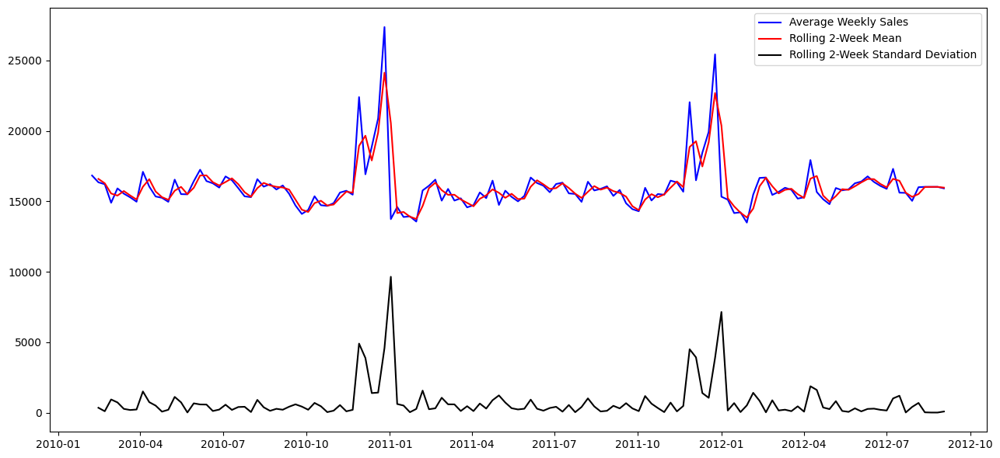

In [34]:

# finding 2-weeks rolling mean and std
roll_mean = df_week['Weekly_Sales'].rolling(window=2, center=False).mean()
roll_std = df_week['Weekly_Sales'].rolling(window=2, center=False).std()
fig, ax = plt.subplots(figsize=(13, 6))
ax.plot(df_week['Weekly_Sales'], color='blue',label='Average Weekly Sales')
ax.plot(roll_mean, color='red', label='Rolling 2-Week Mean')
ax.plot(roll_std, color='black', label='Rolling 2-Week Standard Deviation')
ax.legend()
fig.tight_layout()

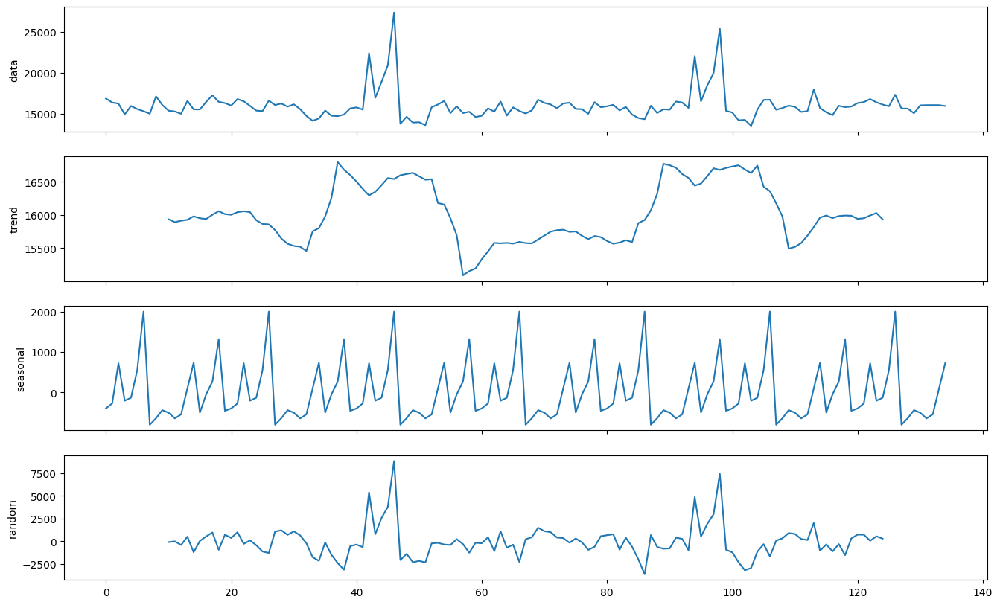

In [36]:
from pmdarima.utils import decomposed_plot
from pmdarima.arima import decompose
decomposed = decompose(df_week['Weekly_Sales'].values, 'additive', m=20) #decomposing of weekly data
decomposed_plot(decomposed, figure_kwargs={'figsize': (16, 10)})
plt.show()

In [37]:

df_week_diff = df_week['Weekly_Sales'].diff().dropna() #creating difference values
# taking mean and std of differenced data
diff_roll_mean = df_week_diff.rolling(window=2, center=False).mean()
diff_roll_std = df_week_diff.rolling(window=2, center=False).std()

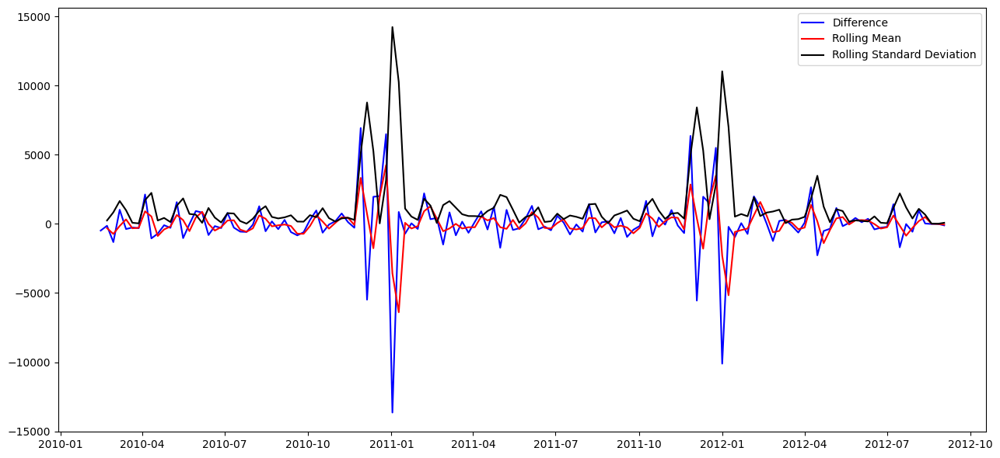

In [38]:
fig, ax = plt.subplots(figsize=(13, 6))
ax.plot(df_week_diff, color='blue',label='Difference')
ax.plot(diff_roll_mean, color='red', label='Rolling Mean')
ax.plot(diff_roll_std, color='black', label='Rolling Standard Deviation')
ax.legend()
fig.tight_layout()


In [39]:
df_week_lag = df_week['Weekly_Sales'].shift().dropna() #shifting the data
lag_roll_mean = df_week_lag.rolling(window=2, center=False).mean()
lag_roll_std = df_week_lag.rolling(window=2, center=False).std()


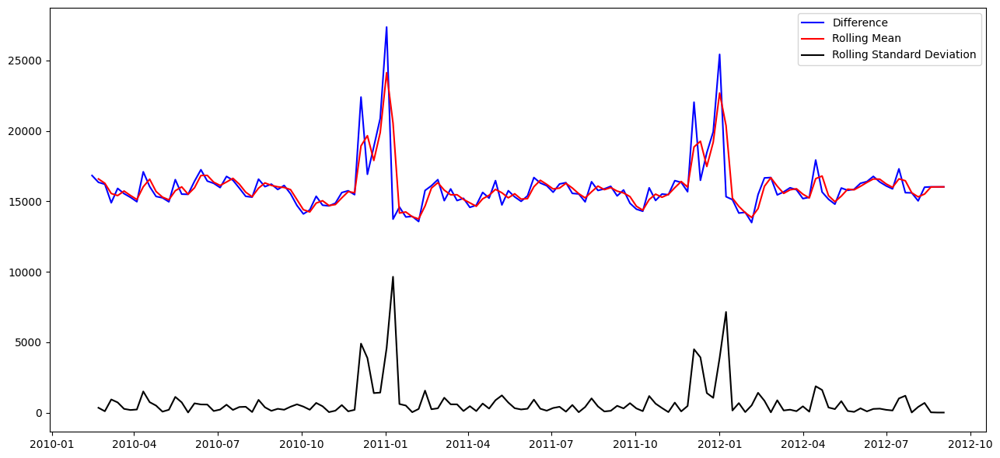

In [40]:

fig, ax = plt.subplots(figsize=(13, 6))
ax.plot(df_week_lag, color='blue',label='Difference')
ax.plot(lag_roll_mean, color='red', label='Rolling Mean')
ax.plot(lag_roll_std, color='black', label='Rolling Standard Deviation')
ax.legend()
fig.tight_layout()

In [41]:
logged_week = np.log1p(df_week['Weekly_Sales']).dropna() #taking log of data
log_roll_mean = logged_week.rolling(window=2, center=False).mean()
log_roll_std = logged_week.rolling(window=2, center=False).std()

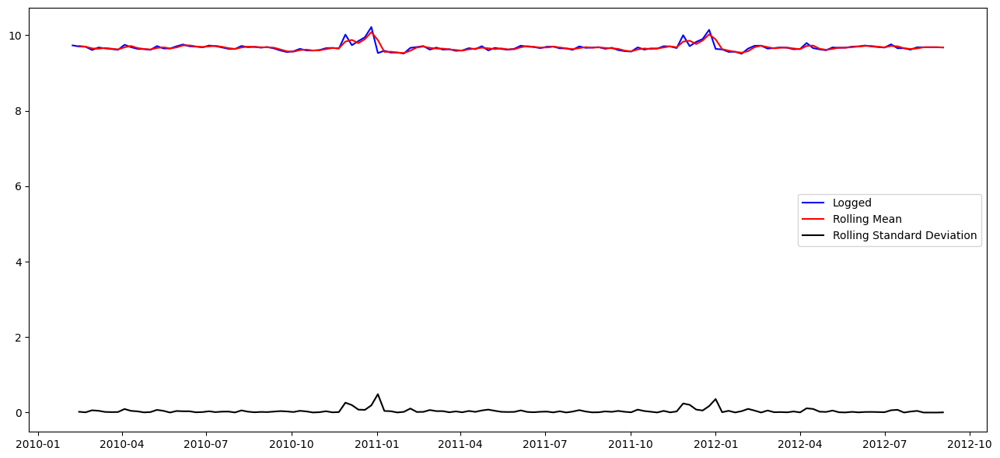

In [42]:
fig, ax = plt.subplots(figsize=(13, 6))
ax.plot(logged_week, color='blue',label='Logged')
ax.plot(log_roll_mean, color='red', label='Rolling Mean')
ax.plot(log_roll_std, color='black', label='Rolling Standard Deviation')
ax.legend()
fig.tight_layout()

## Auto-ARIMA Model

In [ ]:
train_data_diff = df_week_diff
test_data_diff = df_week_diff [int(0.7*(len(df_week_diff ))):]
# train_data = train_data['Weekly_Sales']
# test_data = test_data['Weekly_Sales']

model_auto_arima = auto_arima(train_data_diff, trace=True,start_p=0, start_q=0, start_P=0, start_Q=0,
                  max_p=20, max_q=20, max_P=20, max_Q=20, seasonal=True,maxiter=200,
                  information_criterion='aic',stepwise=False, suppress_warnings=True, D=1, max_D=10,
                  error_action='ignore',approximation = False)
model_auto_arima.fit(train_data_diff)


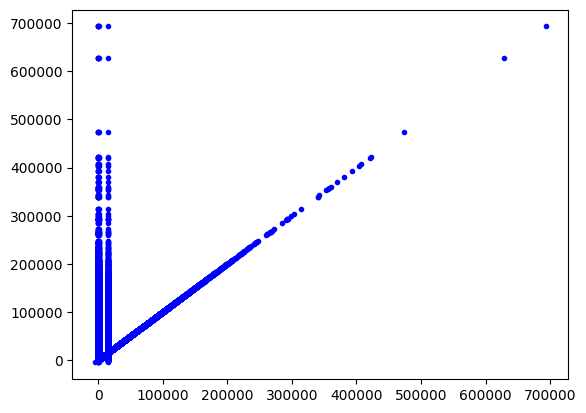

In [153]:
#plot predition
    # Read data for current fold
train = pd.read_csv(f'{DATA_DIR}/fold_1/train.csv')
train=preprocess(train)
pred = pd.read_csv(f'{DATA_DIR}/fold_1/mypred.csv')
pred=preprocess(pred)
plt.plot(pred, pred['Weekly_Pred'], "r-", label="Predictions")
plt.plot(train, train['Weekly_Sales'], "b.")
[...]  # beautify the figure: add labels, axis, grid, and legend
plt.show()

In [187]:

from sklearn.preprocessing import add_dummy_feature
from sklearn.preprocessing import OneHotEncoder

train = pd.read_csv(f'{DATA_DIR}/fold_1/train.csv')
test = pd.read_csv(f'{DATA_DIR}/fold_1/test.csv')
train=preprocess(train)
test=preprocess(test)
departments = train['Dept'].unique()

train_cat = train[["Wk"]]
test_cat = test[["Wk"]]

# data = pd.get_dummies(train, columns=['Wk'], prefix='Wk', drop_first=True)

encoder = OneHotEncoder(categories=[range(1, 53)], drop='first',handle_unknown='ignore')
wk_encoded=encoder.fit_transform(train_cat)
wk_encoded_array=wk_encoded.toarray()

print(f'cat_encoder.categories_ for weeks in train are {cat_encoder.categories_}')

wk_encoded_test=encoder.transform(test_cat)
wk_encoded_test_array=wk_encoded_test.toarray()
print(f'one hot test array is {wk_encoded_test_array}')

print(f'cat_encoder.feature_names_in_ {encoder.feature_names_in_}')
print(f'cat_encoder.get_feature_names_out() {encoder.get_feature_names_out()}')

# Create a DataFrame from the encoded 'Wk' columns
wk_encoded_df = pd.DataFrame(wk_encoded_array, columns=encoder.get_feature_names_out(['Wk']), index=train.index)
y=train['Weekly_Sales']
# Concatenate the one-hot encoded columns with the original DataFrame
train = pd.concat([train.drop(columns=['Wk','Date','Weekly_Sales','Store', 'Dept']), wk_encoded_df], axis=1)



    # Create a DataFrame from the encoded 'Wk' columns
wk_encoded_test_df = pd.DataFrame(wk_encoded_test_array, columns=encoder.get_feature_names_out(['Wk']), index=test.index)

tmp_pred = test[['Store', 'Dept', 'Date','IsHoliday']]

    # Concatenate the one-hot encoded columns with the original DataFrame
test = pd.concat([test.drop(columns=['Wk','Date','Store', 'Dept']), wk_encoded_test_df], axis=1)

from sklearn.preprocessing import PolynomialFeatures
poly_features = PolynomialFeatures(degree=2, include_bias=False)
X_poly = poly_features.fit_transform(train)

test_poly = poly_features.transform(test)

# X_b = add_dummy_feature(train)  # add x0 = 1 to each instance
# theta_best1 = np.linalg.inv(X_b.T @ X_b) @ X_b.T @ y

# theta_best_svd, residuals, rank, s = np.linalg.lstsq(X_b, y, rcond=1e-6)
# theta_best2=np.linalg.pinv(X_b) @ y
# print(np.array_equal(theta_best2, theta_best_svd))  # True
# print((np.linalg.pinv(X_b) @ y).shape)
# X_b.shape

from sklearn.linear_model import LinearRegression


lin_reg = LinearRegression()
# lin_reg.fit(train, y)
lin_reg.fit(X_poly, y)



print(lin_reg.intercept_)
print(lin_reg.coef_)
print(X_poly)




cat_encoder.categories_ for weeks in train are [array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52])]
one hot test array is [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
cat_encoder.feature_names_in_ ['Wk']
cat_encoder.get_feature_names_out() ['Wk_2' 'Wk_3' 'Wk_4' 'Wk_5' 'Wk_6' 'Wk_7' 'Wk_8' 'Wk_9' 'Wk_10' 'Wk_11'
 'Wk_12' 'Wk_13' 'Wk_14' 'Wk_15' 'Wk_16' 'Wk_17' 'Wk_18' 'Wk_19' 'Wk_20'
 'Wk_21' 'Wk_22' 'Wk_23' 'Wk_24' 'Wk_25' 'Wk_26' 'Wk_27' 'Wk_28' 'Wk_29'
 'Wk_30' 'Wk_31' 'Wk_32' 'Wk_33' 'Wk_34' 'Wk_35' 'Wk_36' 'Wk_37' 'Wk_38'
 'Wk_39' 'Wk_40' 'Wk_41' 'Wk_42' 'Wk_43' 'Wk_44' 'Wk_45' 'Wk_46' 'Wk_47'
 'Wk_48' 'Wk_49' 'Wk_50' 'Wk_51' 'Wk_52']
1.0350067966526548e+16
[ 7.50211966e+09 -1.02959538e+13 

In [188]:

y_predict= lin_reg.predict(test_poly)
# Prepare test predictions DataFrame
test_pred = pd.DataFrame(index=test.index)
test_pred['Weekly_Pred']=y_predict
test_pred = pd.concat([test_pred, tmp_pred], ignore_index=True)


In [149]:
test_pred=pd.DataFrame()
X_new_b = add_dummy_feature(test)  # add x0 = 1 to each instance
y_predict = X_new_b @ theta_best2
test_pred['Weekly_Pred']=y_predict


test_pred = pd.concat([test_pred, tmp_pred], ignore_index=True)



In [189]:
test_pred['Weekly_Pred'].fillna(0, inplace=True)
test_pred.to_csv(f'{DATA_DIR}/fold_1/mypred.csv', index=False)

<ipython-input-189-e1e7b213b20d>:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  test_pred['Weekly_Pred'].fillna(0, inplace=True)


In [1]:
!pip install ISLP

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 kB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 19.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 349.3/349.3 kB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 522.0/522.0 kB 15.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 36.4/36.4 MB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 20.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 890.6/890.6 kB 16.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.5/94.5 kB 5.6 MB/s eta 0:00:00
  Created wheel for autograd-gamma: filename=autograd_gamma-0.5.0-py3-none-any.whl size=4031 sha256=d703d8b0fef6420544af34836e26ea962759bbebdf69c364611f896a7f259d22
  Stored in directory: /root/.cache/pip/wheels/25/cc/e0/ef2969164144c899fedb22b338f6703e2b9cf46eeebf254991
Successfully built autograd-gamma
  Attempting un

In [3]:
import numpy as np, pandas as pd
from matplotlib.pyplot import subplots
import statsmodels.api as sm
from ISLP import load_data
from ISLP.models import (summarize,
                         poly,
                         ModelSpec as MS)
from statsmodels.stats.anova import anova_lm

In [2]:
from pygam import (s as s_gam,
                   l as l_gam,
                   f as f_gam,
                   LinearGAM,
                   LogisticGAM)

from ISLP.transforms import (BSpline,
                             NaturalSpline)
from ISLP.models import bs, ns
from ISLP.pygam import (approx_lam,
                        degrees_of_freedom,
                        plot as plot_gam,
                        anova as anova_gam)


In [68]:
 # Read data for current fold
train = pd.read_csv(f'{DATA_DIR}/fold_1/train.csv')
test = pd.read_csv(f'{DATA_DIR}/fold_1/test.csv')

In [69]:
train=preprocess(train)

In [70]:
test=preprocess(test)



In [71]:
y = train['Weekly_Sales']
year = train['Yr']
train

,Store,Dept,Date,Weekly_Sales,IsHoliday,Wk,Yr
0,1,1,2010-02-05,24924.50,0,5,2010
1,1,1,2010-02-12,46039.49,1,6,2010
2,1,1,2010-02-19,41595.55,0,7,2010
3,1,1,2010-02-26,19403.54,0,8,2010
4,1,1,2010-03-05,21827.90,0,9,2010
...,...,...,...,...,...,...,...
164110,45,98,2011-01-28,77.00,0,4,2011
164111,45,98,2011-02-04,57.25,0,5,2011
164112,45,98,2011-02-11,388.80,1,6,2011
164113,45,98,2011-02-18,284.50,0,7,2011


In [90]:
X = MS(['Yr']).fit_transform(train)
model1 = sm.OLS(y, X)
results1 = model1.fit()
summarize(results1)


,coef,std err,t,P>|t|
intercept,2.699000e+06,325000.000,8.316,0.0
Yr,-1.334481e+03,161.433,-8.266,0.0


In [66]:
def abline(ax, b, m, *args, **kwargs):
    "Add a line with slope m and intercept b to ax"
    xlim = ax.get_xlim()
    ylim = [m * xlim[0] + b, m * xlim[1] + b]
    ax.plot(xlim, ylim, *args, **kwargs)


<ipython-input-31-7f4c5bb5a20f>:3: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  results1.params[0],
<ipython-input-31-7f4c5bb5a20f>:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  results1.params[1],


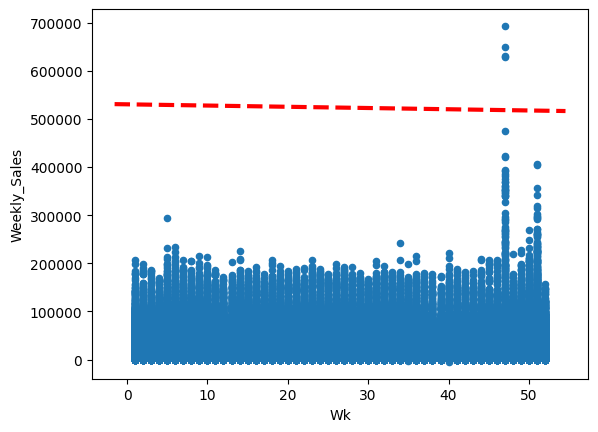

In [31]:
ax = train.plot.scatter('Wk', 'Weekly_Sales')
abline(ax,
       results1.params[0],
       results1.params[1],
       'r--',
       linewidth=3)

In [ ]:
departments = train['Dept'].unique()
spec = MS([poly('Yr', degree=2), 'Wk'])
X = spec.fit_transform(train)



        # Process each department
for department in departments:

            filtered_train = train[train['Dept'] == department]
            # y = filtered_train['Weekly_Sales']

            test_dept_data = test[test['Dept'] == department]

            train_stores = filtered_train['Store'].unique()
            test_stores = test_dept_data['Store'].unique()
            test_stores = list(set(train_stores).intersection(test_stores))

            for store in test_stores:
            # X = MS([poly('Yr', degree=2), 'Wk']).fit_transform(train)
                model1 = sm.OLS(y, X)
                results2 = model1.fit()
                summarize(results2)

                test_pred = pd.DataFrame()
                tmp_pred = test[['Store', 'Dept', 'Date', 'IsHoliday']]

                # Step 1: Transform the test data using the fitted ModelSpec
                X_test = spec.transform(test)
                preds = results2.get_prediction(X_test)



                tmp_pred['Weekly_Pred'] =  preds.predicted_mean

                test_pred = pd.concat([test_pred, tmp_pred], ignore_index=True)




In [32]:
test_pred = pd.DataFrame()
tmp_pred = test[['Store', 'Dept', 'Date', 'IsHoliday']]

# Step 1: Transform the test data using the fitted ModelSpec
X_test = spec.transform(test)
preds = results2.get_prediction(X_test)



tmp_pred['Weekly_Pred'] =  preds.predicted_mean

test_pred = pd.concat([test_pred, tmp_pred], ignore_index=True)



<ipython-input-32-c88d79895dc6>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tmp_pred['Weekly_Pred'] =  preds.predicted_mean


In [33]:
test_pred['Weekly_Pred'].fillna(0, inplace=True)
test_pred.to_csv(f'{DATA_DIR}/fold_1/mypred.csv', index=False)

<ipython-input-33-e1e7b213b20d>:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  test_pred['Weekly_Pred'].fillna(0, inplace=True)


In [16]:

def myeval():
    test_with_label = pd.read_csv(f'{DATA_DIR}/test_with_label.csv')
    num_folds = 10
    wae = []

    for i in range(num_folds):
        file_path = f'{DATA_DIR}/fold_1/test.csv'
        test = pd.read_csv(file_path)
        test = test.drop(columns=['IsHoliday']).merge(test_with_label, on=['Date', 'Store', 'Dept'])

        file_path = f'{DATA_DIR}/fold_1/mypred.csv'
        test_pred = pd.read_csv(file_path)
        test_pred = test_pred.drop(columns=['IsHoliday'])

        new_test = test.merge(test_pred, on=['Date', 'Store', 'Dept'], how='left')

        actuals = new_test['Weekly_Sales']
        preds = new_test['Weekly_Pred']
        weights = new_test['IsHoliday'].apply(lambda x: 5 if x else 1)
        wae.append(sum(weights * abs(actuals - preds)) / sum(weights))

    return wae

In [17]:
wae = myeval()
for value in wae:
    print(f"\t{value:.3f}")
print(f"{sum(wae) / len(wae):.3f}")

	nan
	nan
	nan
	nan
	nan
	nan
	nan
	nan
	nan
	nan
nan


In [31]:
test

,Store,Dept,Date,IsHoliday,Wk,Yr
0,1,1,2011-03-04,0,9,2011
1,1,1,2011-03-11,0,10,2011
2,1,1,2011-03-18,0,11,2011
3,1,1,2011-03-25,0,12,2011
4,1,1,2011-04-01,0,13,2011
...,...,...,...,...,...,...
26554,45,98,2011-04-01,0,13,2011
26555,45,98,2011-04-08,0,14,2011
26556,45,98,2011-04-15,0,15,2011
26557,45,98,2011-04-22,0,16,2011


In [180]:
test=test.drop(['Store','Dept','Date','IsHoliday'],axis=1)


KeyError: "['Store', 'Dept', 'Date', 'IsHoliday'] not found in axis"

In [183]:
test['Yr_squared'] = test['Yr'] ** 2
results2.params


,0
intercept,14775.772254
"poly(Yr, degree=2)[0]",0.000112
"poly(Yr, degree=2)[1]",0.018857
Wk[2],-707.961489
Wk[3],-666.877588
Wk[4],-1033.005511
Wk[5],1604.684969
Wk[6],1529.720900
Wk[7],1675.676960
Wk[8],271.860769


In [255]:
models = [MS([poly('Yr', degree=d)])
          for d in range(1, 3)]
Xs = [model.fit_transform(train) for model in models]
anova_lm(*[sm.OLS(y, X_).fit()
           for X_ in Xs])

#The p-value comparing the linear models[0] to the quadratic models[1] is essentially zero, indicating that a linear fit is not sufficient.

,df_resid,ssr,df_diff,ss_diff,F,Pr(>F)
0,397839.0,2.061549e+14,0.0,NaN,NaN,NaN
1,397838.0,2.061546e+14,1.0,386316803.5,0.745516,0.3879


In [256]:
summarize(M)


,coef,std err,t,P>|t|
intercept,16020.0,36.09,443.805,0.000
"poly(Yr, degree=2)[0]",-125500.0,22800.00,-5.514,0.000
"poly(Yr, degree=2)[1]",19650.0,22800.00,0.863,0.388


In [274]:
models = [MS(['Wk', poly('Yr', degree=d)])
          for d in range(1, 3)]
XEs = [model.fit_transform(train)
       for model in models]
anova_lm(*[sm.OLS(y, X_).fit() for X_ in XEs])

summarize(M)


ValueError: The indices for endog and exog are not aligned